# Imports

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import torch
import torch.nn as nn

In [ ]:
!pip install kagglehub

In [ ]:
import kagglehub

github

In [ ]:
!git clone https://github.com/DepthAnything/Depth-Anything-V2.git


fatal: destination path 'Depth-Anything-V2' already exists and is not an empty directory.


In [ ]:
!pip install -r Depth-Anything-V2/metric_depth/requirements.txt

In [ ]:
!pip install datasets

In [ ]:
# Assicurati di essere nella cartella corretta
%cd /content/Depth-Anything-V2/metric_depth



/content/Depth-Anything-V2/metric_depth


In [ ]:
# Creiamo la directory del dataset se non esiste
%mkdir -p /content/Depth-Anything-V2/metric_depth/dataset

# Scriviamo il nostro data loader NYU personalizzato in un nuovo file

#Globals

In [ ]:
import os
from google.colab import files

CHECKPOINT_DIR = './checkpoints'
CHECKPOINT_NAME = 'latest.pth'
CHECKPOINT_PATH = os.path.join(CHECKPOINT_DIR, CHECKPOINT_NAME)

os.makedirs(CHECKPOINT_DIR, exist_ok=True)

if not os.path.exists(CHECKPOINT_PATH):
    print(f"⚠️ File '{CHECKPOINT_NAME}' non trovato.")
    print("👉 Per favore, carica il tuo file checkpoint (.pth) ora:")

    uploaded = files.upload()

    for filename in uploaded.keys():
        os.rename(filename, CHECKPOINT_PATH)
        print(f"✅ File salvato e rinominato in: {CHECKPOINT_PATH}")
        break
else:
    print(f"✅ Checkpoint già pronto: {CHECKPOINT_PATH}")

In [ ]:
CONTINUE_TRAINING = False
TRAINING = False

In [ ]:
ATTACCO1 = False

In [ ]:
ATTACCO2 =False

In [ ]:
ATTACCO3_1 = False

In [ ]:
ATTACCO3_2 = False

In [ ]:
ATTACCO4_1=False

In [ ]:
ATTACCO5_1=False

In [ ]:
ATTACCO5_2=False

In [ ]:
ATTACCO5_3  =False

In [ ]:
ATTACCO5_4 = False

In [ ]:
ATTACCO5_5  =False

In [ ]:
ATTACCO5_6 = False

#Utils

In [ ]:


class NonPrintabilityScore(nn.Module):
    def __init__(self, printability_file=None, device='cpu'):
        super(NonPrintabilityScore, self).__init__()
        self.device = device

        # Definiamo manualmente una palette di colori "sicuri" per la stampa (CMYK base + varianti)
        # Questi sono valori RGB normalizzati [0,1] che le stampanti gestiscono bene
        self.printable_colors = torch.tensor([
            [0.0, 0.0, 0.0], [1.0, 1.0, 1.0], # Nero, Bianco
            [0.5, 0.5, 0.5], # Grigio
            [0.0, 1.0, 1.0], [1.0, 0.0, 1.0], [1.0, 1.0, 0.0], # Ciano, Magenta, Giallo
            [1.0, 0.0, 0.0], [0.0, 1.0, 0.0], [0.0, 0.0, 1.0], # RGB puri
            [0.5, 0.0, 0.0], [0.0, 0.5, 0.0], [0.0, 0.0, 0.5], # Colori scuri
            [0.9, 0.9, 0.9], [0.1, 0.1, 0.1]  # Quasi bianco/nero
        ]).to(device)

    def forward(self, patch):
        # patch shape: [1, 3, H, W] -> [N_pixels, 3]
        patch_pixels = patch.permute(0, 2, 3, 1).reshape(-1, 3)

        # Calcola la distanza di ogni pixel da TUTTI i colori stampabili
        # Distanza: |Pixel - Color|
        # Usiamo broadcasting per calcolare tutto insieme
        dists = torch.cdist(patch_pixels, self.printable_colors, p=2)

        # Per ogni pixel, prendi la distanza dal colore stampabile PIÙ VICINO
        min_dists, _ = torch.min(dists, dim=1)

        # La loss è la somma di queste distanze minime
        nps_loss = torch.sum(min_dists)
        return nps_loss

# Data

In [ ]:


import os
from google.colab import files

# 1. Installa la libreria
!pip install -q kaggle

# 2. Crea la cartella di configurazione (se non esiste)
!mkdir -p ~/.kaggle

# 3. Controlla se il file è già presente (magari caricato nella sessione), altrimenti chiedi di caricarlo
if not os.path.exists('kaggle.json'):
    print("⚠️ File kaggle.json non trovato.")
    print("Per favore, carica il file kaggle.json ora:")
    uploaded = files.upload()

    # Prendi il nome del file caricato (per sicurezza)
    filename = next(iter(uploaded))
else:
    print("✅ File kaggle.json trovato nella directory corrente.")
    filename = 'kaggle.json'

# 4. Sposta il file nella cartella corretta
# Usiamo comandi python/shell generici
!cp {filename} ~/.kaggle/kaggle.json

# 5. Imposta i permessi (obbligatorio)
!chmod 600 ~/.kaggle/kaggle.json

print("Setup Kaggle completato!")

Kaggle configurato correttamente usando il file da Drive!


In [ ]:
# import kagglehub

# Download latest version
print("Downloading soumikrakshit/nyu-depth-v2 using kagglehub...")
path = kagglehub.dataset_download("soumikrakshit/nyu-depth-v2")

print("Path to dataset files:", path)

# List the contents of the downloaded directory to see the structure
!ls -lh {path}

Path to dataset files: /root/.cache/kagglehub/datasets/soumikrakshit/nyu-depth-v2/versions/1
total 4.0K
drwxr-xr-x 3 root root 4.0K Jan  8 15:57 nyu_data


Modifica di dataset.py

In [ ]:
%%writefile /content/Depth-Anything-V2/metric_depth/dataset/nyu.py
import torch
from torch.utils.data import Dataset
import pandas as pd
import numpy as np
import os
import cv2
from torchvision.transforms import Compose

# Importazione sicura
try:
    from dataset.transform import Resize, NormalizeImage, PrepareForNet
except ImportError:
    from transform import Resize, NormalizeImage, PrepareForNet

class NYUDataset(Dataset):
    def __init__(self, split='train', size=(518, 518), kaggle_path=None):
        if kaggle_path is None:
            raise ValueError("Serve il percorso kaggle_path")

        self.kaggle_path = kaggle_path
        self.base_dir = os.path.join(self.kaggle_path, 'nyu_data')
        self.split = split # Salviamo lo split per usarlo in __getitem__

        csv_name = 'nyu2_train.csv' if split == 'train' else 'nyu2_test.csv'
        csv_path = os.path.join(self.base_dir, 'data', csv_name)

        if not os.path.exists(csv_path):
             raise FileNotFoundError(f"CSV non trovato: {csv_path}")

        self.data = pd.read_csv(csv_path, header=None)

        # Pipeline di trasformazione
        self.transform = Compose([
            Resize(
                width=size[0],
                height=size[1],
                resize_target=True,
                keep_aspect_ratio=True,
                ensure_multiple_of=14,
                resize_method='lower_bound',
                image_interpolation_method=cv2.INTER_CUBIC,
            ),
            NormalizeImage(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            PrepareForNet(),
        ])

        print(f"Dataset {split} caricato: {len(self)} campioni.")

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_rel, depth_rel = self.data.iloc[idx, 0], self.data.iloc[idx, 1]
        img_path = os.path.join(self.base_dir, img_rel)
        depth_path = os.path.join(self.base_dir, depth_rel)

        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Lettura Depth (IMREAD_UNCHANGED legge sia 8-bit che 16-bit correttamente)
        depth = cv2.imread(depth_path, cv2.IMREAD_UNCHANGED)

        if image is None or depth is None:
             raise RuntimeError(f"Errore lettura: {img_path} o {depth_path}")

        # --- NORMALIZZAZIONE CONDIZIONALE (IL FIX CRUCIALE) ---

        # Immagine sempre 0-255 -> 0-1
        image = image.astype(np.float32) / 255.0

        depth = depth.astype(np.float32)

        if self.split == 'train':
            # TRAINING SET: 8-bit (0-255) mappato su 0-10 metri
            # (valore / 255) * 10.0
            depth = (depth / 255.0) * 10.0
        else:
            # TEST SET: 16-bit (millimetri)
            # valore / 1000.0
            depth = depth / 1000.0

        # Creiamo il dizionario per la pipeline
        sample = {'image': image, 'depth': depth}
        sample = self.transform(sample)

        img_np = sample['image']
        depth_np = sample['depth']

        # Valid Mask (0.1m - 10m)
        valid_mask = (depth_np > 0.1) & (depth_np < 10.0)

        return {
            'image': torch.from_numpy(img_np),
            'depth': torch.from_numpy(depth_np),
            'valid_mask': torch.from_numpy(valid_mask)
        }

Overwriting /content/Depth-Anything-V2/metric_depth/dataset/nyu.py


#Network

Modifica di train.py

In [ ]:
%%writefile /content/Depth-Anything-V2/metric_depth/train.py
import argparse
import logging
import os
import pprint
import random
import numpy as np
import torch
import torch.backends.cudnn as cudnn
import torch.distributed as dist
from torch.utils.data import DataLoader
from torch.optim import AdamW
import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter

# Import dataset custom
from dataset.nyu import NYUDataset
from depth_anything_v2.dpt import DepthAnythingV2
from util.dist_helper import setup_distributed
from util.loss import SiLogLoss
from util.metric import eval_depth
from util.utils import init_log

parser = argparse.ArgumentParser(description='Depth Anything V2 Metric Depth')
parser.add_argument('--encoder', default='vits', choices=['vits', 'vitb', 'vitl', 'vitg'])
parser.add_argument('--dataset', default='nyu', choices=['hypersim', 'vkitti', 'nyu'])
parser.add_argument('--data-path', type=str, required=True)
parser.add_argument('--img-size', default=518, type=int)
parser.add_argument('--min-depth', default=0.001, type=float)
parser.add_argument('--max-depth', default=10, type=float)
parser.add_argument('--epochs', default=20, type=int)
parser.add_argument('--bs', default=2, type=int)
parser.add_argument('--lr', default=0.000005, type=float)
parser.add_argument('--pretrained-from', type=str)
parser.add_argument('--save-path', type=str, required=True)
parser.add_argument('--local-rank', default=0, type=int)
parser.add_argument('--port', default=None, type=int)

def main():
    args = parser.parse_args()
    logger = init_log('global', logging.INFO)
    logger.propagate = 0
    rank, world_size = setup_distributed(port=args.port)

    if rank == 0:
        all_args = {**vars(args), 'ngpus': world_size}
        logger.info('{}\n'.format(pprint.pformat(all_args)))
        writer = SummaryWriter(args.save_path)

    cudnn.enabled = True
    cudnn.benchmark = True

    size = (args.img_size, args.img_size)

    # Dataset NYU
    if args.dataset == 'nyu':
        trainset = NYUDataset(split='train', size=size, kaggle_path=args.data_path)
    else:
        raise NotImplementedError

    # Sampler Distribuito
    trainsampler = torch.utils.data.distributed.DistributedSampler(trainset)
    trainloader = DataLoader(trainset, batch_size=args.bs, pin_memory=True, num_workers=2, drop_last=True, shuffle=False, sampler=trainsampler)

    if args.dataset == 'nyu':
        valset = NYUDataset(split='test', size=size, kaggle_path=args.data_path)

    valsampler = torch.utils.data.distributed.DistributedSampler(valset, shuffle=False)
    valloader = DataLoader(valset, batch_size=1, pin_memory=True, num_workers=2, drop_last=True, shuffle=False, sampler=valsampler)

    local_rank = int(os.environ["LOCAL_RANK"])
    model = DepthAnythingV2(encoder=args.encoder, features=64, out_channels=[48, 96, 192, 384], max_depth=args.max_depth)

    if args.pretrained_from:
        checkpoint = torch.load(args.pretrained_from, map_location='cpu')
        state_dict = checkpoint.get('model', checkpoint)
        if 'depth_anything_v2_vits.pth' in args.pretrained_from:
             model.load_state_dict({k: v for k, v in state_dict.items() if 'pretrained' in k}, strict=False)
        else:
             model.load_state_dict(state_dict, strict=False)

    model = torch.nn.SyncBatchNorm.convert_sync_batchnorm(model)
    model.cuda(local_rank)
    model = torch.nn.parallel.DistributedDataParallel(model, device_ids=[local_rank], broadcast_buffers=False, output_device=local_rank, find_unused_parameters=True)

    # FIX: L1 Loss per imparare i metri
    criterion = torch.nn.L1Loss().cuda(local_rank)

    optimizer = AdamW([{'params': [param for name, param in model.named_parameters() if 'pretrained.blocks' in name], 'lr': args.lr},
                       {'params': [param for name, param in model.named_parameters() if not 'pretrained.blocks' in name], 'lr': args.lr * 10.0}],
                      lr=args.lr, betas=(0.9, 0.999), weight_decay=0.01)

    start_epoch = 0

    for epoch in range(start_epoch, args.epochs):
        if rank == 0: logger.info(f"Inizio Epoca {epoch}...")
        trainloader.sampler.set_epoch(epoch)
        model.train()

        for i, sample in enumerate(trainloader):
            optimizer.zero_grad()
            img, depth, valid_mask = sample['image'].cuda(), sample['depth'].cuda(), sample['valid_mask'].cuda()

            if random.random() < 0.5:
                img = img.flip(-1); depth = depth.flip(-1); valid_mask = valid_mask.flip(-1)

            pred = model(img)

            mask = (valid_mask == 1) & (depth >= args.min_depth) & (depth <= args.max_depth)
            if mask.sum() < 1: continue

            loss = criterion(pred[mask], depth[mask])
            loss.backward()
            optimizer.step()

            if rank == 0 and i % 100 == 0:
                logger.info('Epoch: {}/{}, Iter: {}/{}, Loss: {:.3f}'.format(epoch, args.epochs, i, len(trainloader), loss.item()))

        model.eval()
        results = {'d1': torch.tensor([0.0]).cuda(), 'abs_rel': torch.tensor([0.0]).cuda()}
        nsamples = torch.tensor([0.0]).cuda()

        with torch.no_grad():
             for i, sample in enumerate(valloader):
                  img, depth, valid_mask = sample['image'].cuda().float(), sample['depth'].cuda(), sample['valid_mask'].cuda()
                  depth = depth[0]; valid_mask = valid_mask[0]
                  pred = model(img)
                  pred = F.interpolate(pred[:, None], depth.shape[-2:], mode='bilinear', align_corners=True)[0, 0]

                  mask = (valid_mask == 1) & (depth >= args.min_depth) & (depth <= args.max_depth)
                  if mask.sum() < 10: continue

                  cur_results = eval_depth(pred[mask], depth[mask])
                  results['d1'] += cur_results['d1']
                  results['abs_rel'] += cur_results['abs_rel']
                  nsamples += 1

        dist.reduce(nsamples, dst=0); dist.reduce(results['d1'], dst=0); dist.reduce(results['abs_rel'], dst=0)

        if rank == 0:
             logger.info(f"Epoch: {epoch} | d1: {(results['d1']/nsamples).item():.3f} | abs_rel: {(results['abs_rel']/nsamples).item():.3f}")
             checkpoint = {'model': model.module.state_dict(), 'optimizer': optimizer.state_dict(), 'epoch': epoch}
             torch.save(checkpoint, os.path.join(args.save_path, 'latest.pth'))

if __name__ == '__main__':
    main()

Overwriting /content/Depth-Anything-V2/metric_depth/train.py


#Train

In [ ]:
# --- 5. TRAINING LOOP UNIFICATO E CORRETTO ---

if 'path' not in locals():
    print("❌ ERRORE CRITICO: La variabile 'path' (Dataset) non è definita.")
    print("👉 Esegui la cella di download del dataset (Kaggle) prima di questa!")
else:
    # A) LOGICA DI RIPRESA TRAINING (CONTINUE)
    if 'CONTINUE_TRAINING' in locals() and CONTINUE_TRAINING:

        # Cerchiamo il TUO checkpoint nella cartella dove salviamo i risultati
        # Assumiamo si chiami 'latest.pth' (standard del training) o usiamo quello che c'è.
        RESUME_PATH = os.path.join(SAVE_PATH, 'latest.pth')

        # Controllo di sicurezza: se non c'è latest.pth, cerchiamo qualsiasi .pth nella cartella
        if not os.path.exists(RESUME_PATH):
            files_in_dir = [f for f in os.listdir(SAVE_PATH) if f.endswith('.pth')]
            if files_in_dir:
                RESUME_PATH = os.path.join(SAVE_PATH, files_in_dir[0])
                print(f"⚠️ 'latest.pth' non trovato, userò: {RESUME_PATH}")
            else:
                print(f"❌ ERRORE: Hai chiesto di continuare, ma in {SAVE_PATH} non ci sono file .pth!")
                # Fallback estremo o stop? Meglio fermarsi per non sovrascrivere.
                raise FileNotFoundError("Nessun checkpoint trovato per riprendere il training.")

        print(f"🔄 RIPRESA TRAINING (Resume)...")
        print(f"📂 Carico i pesi da: {RESUME_PATH}")
        print(f"💾 Output salvato in: {SAVE_PATH}")

        # NOTA: Qui --pretrained-from punta a RESUME_PATH (il tuo file), non al modello base!
        !torchrun --nproc_per_node=1 train.py \
          --dataset nyu \
          --encoder vits \
          --bs 8 \
          --epochs 5 \
          --max-depth 10 \
          --data-path {path} \
          --save-path {SAVE_PATH} \
          --pretrained-from {RESUME_PATH}

    # B) LOGICA DI NUOVO TRAINING (START FROM SCRATCH)
    elif 'TRAINING' in locals() and TRAINING:
        print(f"🚀 AVVIO NUOVO TRAINING (Start from Base)...")
        print(f"📂 Carico il modello base da: {PRETRAINED_PATH}")
        print(f"💾 Output salvato in: {SAVE_PATH}")

        # Qui --pretrained-from punta al modello BASE pulito
        !torchrun --nproc_per_node=1 train.py \
          --dataset nyu \
          --encoder vits \
          --bs 8 \
          --epochs 20 \
          --max-depth 10 \
          --data-path {path} \
          --save-path {SAVE_PATH} \
          --pretrained-from {PRETRAINED_PATH}

    else:
        print("⏭️ Training saltato (TRAINING=False).")

visualization

🔄 Preparazione ambiente...


🤖 Caricamento modello da: /content/drive/MyDrive/Vision/depth_anything_v2/checkpoints/latest.pth
Dataset test caricato: 654 campioni.
📚 Dataset caricato: 654 campioni di test.

--- Campione 50 ---
GT Max:   3.212 m
Pred Max: 3.376 m


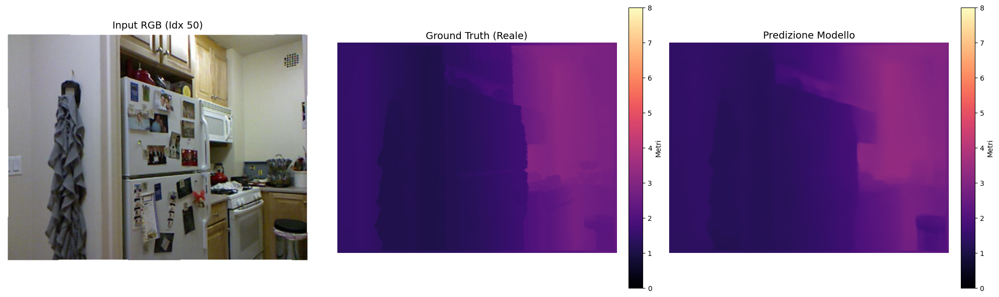


--- Campione 120 ---
GT Max:   8.358 m
Pred Max: 7.899 m


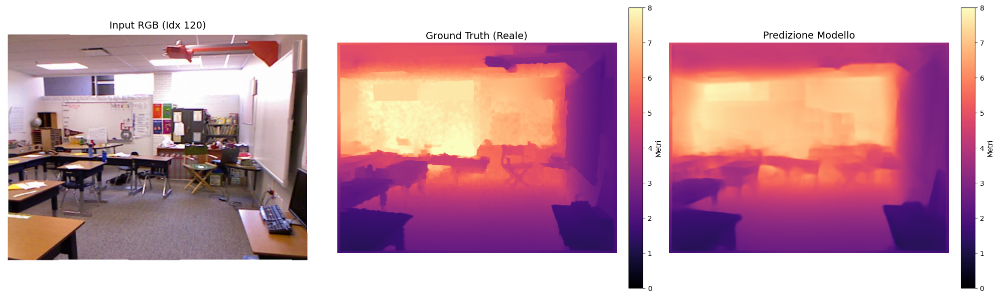


--- Campione 300 ---
GT Max:   3.797 m
Pred Max: 3.775 m


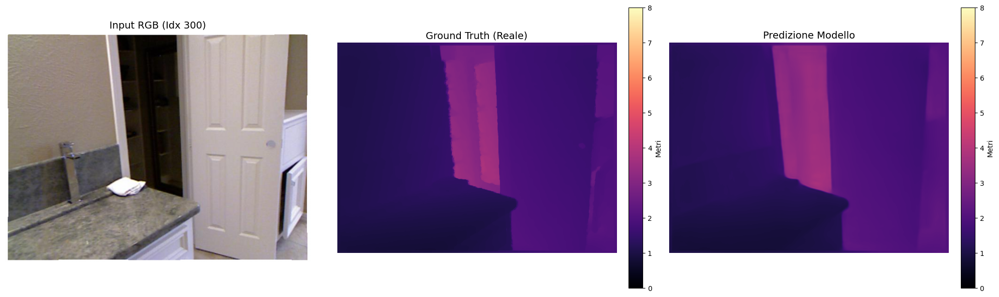

In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import os
import sys
import cv2
import kagglehub

# --- 1. CONFIGURAZIONE AMBIENTE ---
print("🔄 Preparazione ambiente...")

# Setup Directory del Progetto
PROJECT_DIR = '/content/Depth-Anything-V2/metric_depth'
if os.path.exists(PROJECT_DIR):
    if PROJECT_DIR not in sys.path:
        sys.path.append(PROJECT_DIR)
    os.chdir(PROJECT_DIR)
    print(f"📂 Working Directory: {os.getcwd()}")
else:
    raise FileNotFoundError(f"Directory del progetto non trovata: {PROJECT_DIR}. Hai clonato la repo?")

# --- 2. CONFIGURAZIONE PERCORSI  ---

# A) GESTIONE DATASET
if 'path' in locals() and os.path.exists(path):
    DATA_PATH = path
    print(f"✅ Dataset recuperato dalla sessione: {DATA_PATH}")
else:
    print("⬇️ Dataset non trovato in memoria. Download da Kaggle...")
    DATA_PATH = kagglehub.dataset_download("soumikrakshit/nyu-depth-v2")

# B) GESTIONE CHECKPOINT (MODIFICATA PER USARE I TUOI FILE)
# Recuperiamo la directory dei checkpoint definita globalmente o usiamo il default
if 'CHECKPOINT_DIR' in locals():
    SEARCH_DIR = CHECKPOINT_DIR
else:
    SEARCH_DIR = './checkpoints'

CHECKPOINT_PATH = None
BASE_MODEL = './depth_anything_v2_vits.pth'

# 1. Cerca prima 'latest.pth' nella tua cartella
if os.path.exists(os.path.join(SEARCH_DIR, 'latest.pth')):
    CHECKPOINT_PATH = os.path.join(SEARCH_DIR, 'latest.pth')
# 2. Se non c'è, cerca QUALSIASI altro file .pth nella tua cartella (es. quello caricato a mano)
elif os.path.exists(SEARCH_DIR):
    pth_files = [f for f in os.listdir(SEARCH_DIR) if f.endswith('.pth')]
    if pth_files:
        CHECKPOINT_PATH = os.path.join(SEARCH_DIR, pth_files[0])
        print(f"ℹ️ 'latest.pth' non trovato, userò il file trovato: {pth_files[0]}")

# 3. Fallback sul modello base (se proprio non hai caricato nulla)
if CHECKPOINT_PATH is None:
    if os.path.exists(BASE_MODEL):
        CHECKPOINT_PATH = BASE_MODEL
        print(f"⚠️ Nessun tuo checkpoint trovato in {SEARCH_DIR}. Uso il modello base: {CHECKPOINT_PATH}")
    else:
         raise FileNotFoundError("❌ Nessun modello trovato! Carica un checkpoint o scarica il modello base.")
else:
    print(f"✅ Trovato checkpoint personalizzato: {CHECKPOINT_PATH}")


DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Import dopo il setup dei path
from dataset.nyu import NYUDataset
from depth_anything_v2.dpt import DepthAnythingV2

# --- 3. CARICAMENTO MODELLO ---
print(f"🤖 Caricamento modello...")
model_configs = {'vits': {'encoder': 'vits', 'features': 64, 'out_channels': [48, 96, 192, 384]}}
model = DepthAnythingV2(**{**model_configs['vits'], 'max_depth': 10.0})

# Caricamento sicuro
try:
    checkpoint = torch.load(CHECKPOINT_PATH, map_location='cpu')

    if 'model' in checkpoint:
        state_dict = checkpoint['model']
    else:
        state_dict = checkpoint

    # Rimuovi prefisso 'module.' se presente
    state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
    model.load_state_dict(state_dict, strict=False)
    model.to(DEVICE)
    model.eval()
    print("🎉 Modello caricato con successo!")
except Exception as e:
    print(f"❌ Errore nel caricamento dei pesi: {e}")

# --- 4. CARICAMENTO DATASET DI TEST ---
val_dataset = NYUDataset(split='test', kaggle_path=DATA_PATH)
print(f"📚 Dataset test caricato: {len(val_dataset)} campioni.")

# --- 5. FUNZIONE DI VISUALIZZAZIONE ---
def visualize_sample(sample_idx):
    if sample_idx >= len(val_dataset):
        print(f"⚠️ Indice {sample_idx} fuori range. Uso indice 0.")
        sample_idx = 0

    sample = val_dataset[sample_idx]

    img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
    depth_gt = sample['depth'].numpy()

    # Inferenza
    with torch.no_grad():
        pred = model(img_tensor)
        pred = F.interpolate(pred[:, None], depth_gt.shape[-2:], mode='bilinear', align_corners=True)[0, 0]
        pred_np = pred.cpu().numpy()

    # Visualizzazione
    fig, axes = plt.subplots(1, 3, figsize=(20, 6))

    # RGB
    img_vis = sample['image'].permute(1, 2, 0).numpy()
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img_vis = (img_vis * std + mean).clip(0, 1)

    axes[0].imshow(img_vis)
    axes[0].set_title(f"Input RGB (Idx {sample_idx})", fontsize=14)
    axes[0].axis('off')

    # Ground Truth
    im1 = axes[1].imshow(depth_gt, cmap='magma', vmin=0, vmax=10.0)
    axes[1].set_title(f"Ground Truth (Max: {depth_gt.max():.2f}m)", fontsize=14)
    axes[1].axis('off')
    fig.colorbar(im1, ax=axes[1], fraction=0.046, pad=0.04, label='Metri')

    # Predizione
    im2 = axes[2].imshow(pred_np, cmap='magma', vmin=0, vmax=10.0)
    axes[2].set_title(f"Predizione (Max: {pred_np.max():.2f}m)", fontsize=14)
    axes[2].axis('off')
    fig.colorbar(im2, ax=axes[2], fraction=0.046, pad=0.04, label='Metri')

    plt.tight_layout()
    plt.show()

# --- 6. ESECUZIONE ---
print("\n🎨 Generazione visualizzazioni...")
visualize_sample(50)
visualize_sample(120)
visualize_sample(300)

#Evaluation

##Attacks

## 1 fixed patch

In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
if ATTACCO1:
  # --- 1. CONFIGURAZIONE ATTACCO ---
  TARGET_DEPTH = 10.0  # Vogliamo "cancellare" l'oggetto (renderlo lontano)
  PATCH_SIZE = (100, 100) # (Larghezza, Altezza)
  POS_X, POS_Y = 200, 150 # Posizione del patch
  LEARNING_RATE = 0.05
  ITERATIONS = 500

  # --- 2. PREPARAZIONE DATI ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE) # [1, 3, H, W]
  depth_gt = sample['depth'].numpy()

  # Leggiamo le dimensioni reali dall'immagine caricata
  _, _, H, W = img_tensor.shape
  print(f"Dimensioni Immagine rilevate: {H}x{W}")

  # Creiamo una maschera della dimensione corretta
  mask = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask[:, :, POS_Y:POS_Y+PATCH_SIZE[1], POS_X:POS_X+PATCH_SIZE[0]] = 1.0

  # Inizializziamo la Patch Avversaria
  adversarial_patch = torch.rand((1, 3, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)

  optimizer = optim.Adam([adversarial_patch], lr=LEARNING_RATE)

  print(f"🎯 Inizio attacco su Campione {sample_idx}. Obiettivo: Depth -> {TARGET_DEPTH}m nella zona patch.")

  # --- 3. LOOP DI OTTIMIZZAZIONE (ATTACCO) ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # Pad della patch alla dimensione dell'immagine (usando H e W )
      patch_padded = torch.zeros_like(img_tensor)
      patch_padded[:, :, POS_Y:POS_Y+PATCH_SIZE[1], POS_X:POS_X+PATCH_SIZE[0]] = adversarial_patch

      # Combina immagine e patch
      img_adv = img_tensor * (1 - mask) + patch_padded * mask

      # Forward Pass
      pred_adv = model(img_adv)

      # Interpolazione alla dimensione originale (usiamo H, W)
      pred_adv = torch.nn.functional.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # Calcolo Loss (Solo nella zona della patch)
      pred_patch_area = pred_adv * mask
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask

      loss = torch.nn.functional.mse_loss(pred_patch_area, target_val)

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          adversarial_patch.data.clamp_(0, 1)

      losses.append(loss.item())

  # --- 4. VISUALIZZAZIONE RISULTATI ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      # Ricostruzione immagine finale per plot
      patch_padded = torch.zeros_like(img_tensor)
      patch_padded[:, :, POS_Y:POS_Y+PATCH_SIZE[1], POS_X:POS_X+PATCH_SIZE[0]] = adversarial_patch
      img_final_adv = img_tensor * (1 - mask) + patch_padded * mask

      # Predizione finale
      pred_final = model(img_final_adv)
      pred_final = torch.nn.functional.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear', align_corners=True)[0, 0]
      pred_final_np = pred_final.cpu().numpy()

  # Plot
  fig, axes = plt.subplots(2, 2, figsize=(15, 10))

  # Denormalizzazione RGB per visualizzazione
  mean = np.array([0.485, 0.456, 0.406])
  std = np.array([0.229, 0.224, 0.225])

  img_vis = img_tensor[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * std + mean).clip(0, 1)
  axes[0,0].imshow(img_vis)
  axes[0,0].set_title("Originale")

  img_adv_vis = img_final_adv[0].permute(1, 2, 0).cpu().numpy()
  img_adv_vis = (img_adv_vis * std + mean).clip(0, 1)
  axes[0,1].imshow(img_adv_vis)
  axes[0,1].set_title("Attaccata (Con Patch)")

  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Profondità Reale")
  plt.colorbar(im1, ax=axes[1,0], label='Metri')

  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title(f"Profondità Predetta (Target Patch: {TARGET_DEPTH}m)")
  plt.colorbar(im2, ax=axes[1,1], label='Metri')

  plt.tight_layout()
  plt.show()

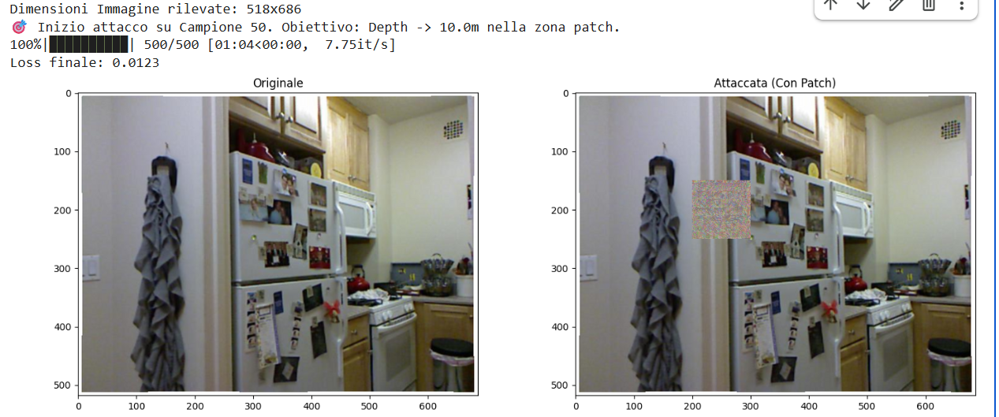

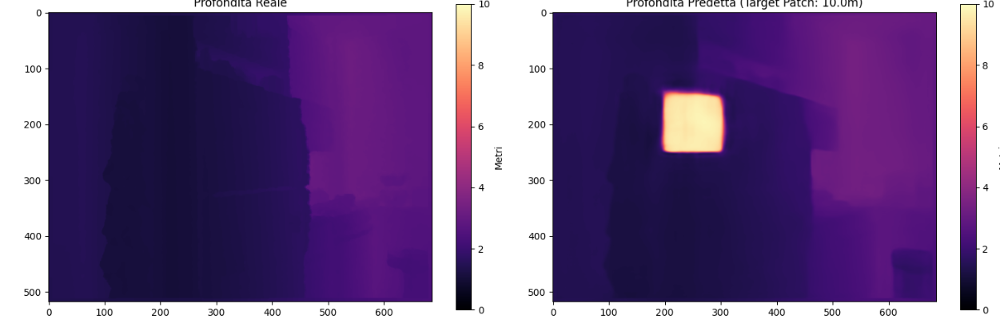

## 2 Object Mask 1

In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
if ATTACCO2:
  # --- CONFIGURAZIONE ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (100, 100)
  # Posizione della patch (dove mettiamo l'adesivo)
  PATCH_POS_X, PATCH_POS_Y = 280, 200

  # Area dell'oggetto che vogliamo far sparire (tutto il frigo)
  OBJ_X, OBJ_Y = 200, 100
  OBJ_W, OBJ_H = 250, 350

  LEARNING_RATE = 0.05
  ITERATIONS = 1000

  # --- DATI ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # --- MASCHERE ---
  # 1. Maschera Patch (Dove modifichiamo i pixel)
  mask_patch = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_patch[:, :, PATCH_POS_Y:PATCH_POS_Y+PATCH_SIZE[1], PATCH_POS_X:PATCH_POS_X+PATCH_SIZE[0]] = 1.0

  # 2. Maschera Oggetto (Dove calcoliamo la Loss - Vogliamo che TUTTO QUESTO sparisca)
  mask_object = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_object[:, :, OBJ_Y:OBJ_Y+OBJ_H, OBJ_X:OBJ_X+OBJ_W] = 1.0

  # Inizializza Patch
  adversarial_patch = torch.rand((1, 3, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)
  optimizer = optim.Adam([adversarial_patch], lr=LEARNING_RATE)

  print(f"🎯 Obiettivo: Nascondere intero frigo ({OBJ_W}x{OBJ_H}) usando una patch di {PATCH_SIZE}.")

  # --- TRAINING ATTACCO ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # Crea immagine attaccata (modifica solo la patch)
      patch_padded = torch.zeros_like(img_tensor)
      patch_padded[:, :, PATCH_POS_Y:PATCH_POS_Y+PATCH_SIZE[1], PATCH_POS_X:PATCH_POS_X+PATCH_SIZE[0]] = adversarial_patch
      img_adv = img_tensor * (1 - mask_patch) + patch_padded * mask_patch

      # Forward
      pred_adv = model(img_adv)
      pred_adv = torch.nn.functional.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # --- CALCOLO LOSS CRUCIALE ---
      # Vogliamo che la profondità sia TARGET_DEPTH (10m) su TUTTO L'OGGETTO
      pred_object_area = pred_adv * mask_object
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_object

      # Aggiungiamo anche una componente di "TV Loss" per rendere la patch più liscia (stampabile)
      tv_loss = torch.sum(torch.abs(adversarial_patch[:, :, :, :-1] - adversarial_patch[:, :, :, 1:])) + \
                torch.sum(torch.abs(adversarial_patch[:, :, :-1, :] - adversarial_patch[:, :, 1:, :]))

      loss = torch.nn.functional.mse_loss(pred_object_area, target_val) + 0.0001 * tv_loss

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          adversarial_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  # Plot
  fig, axes = plt.subplots(2, 2, figsize=(15, 10))

  # Denormalizzazione RGB per visualizzazione
  mean = np.array([0.485, 0.456, 0.406])
  std = np.array([0.229, 0.224, 0.225])

  img_vis = img_tensor[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * std + mean).clip(0, 1)
  axes[0,0].imshow(img_vis)
  axes[0,0].set_title("Originale")

  img_adv_vis = img_final_adv[0].permute(1, 2, 0).cpu().numpy()
  img_adv_vis = (img_adv_vis * std + mean).clip(0, 1)
  axes[0,1].imshow(img_adv_vis)
  axes[0,1].set_title("Attaccata (Con Patch)")

  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Profondità Reale")
  plt.colorbar(im1, ax=axes[1,0], label='Metri')

  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title(f"Profondità Predetta (Target Patch: {TARGET_DEPTH}m)")
  plt.colorbar(im2, ax=axes[1,1], label='Metri')

  plt.tight_layout()
  plt.show()

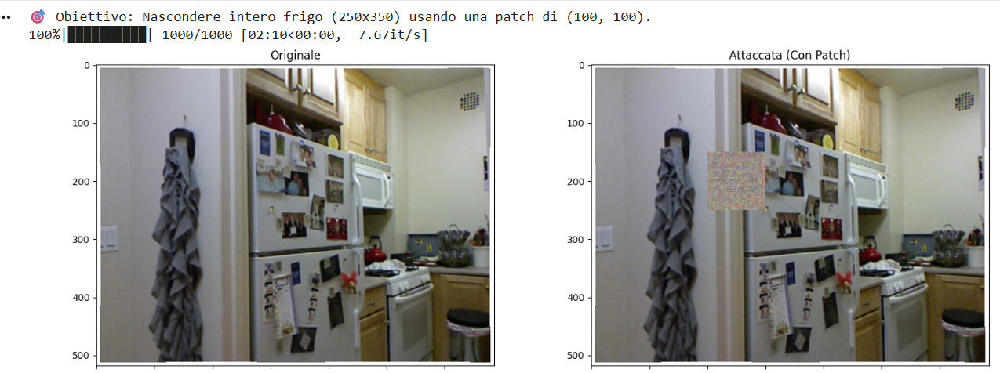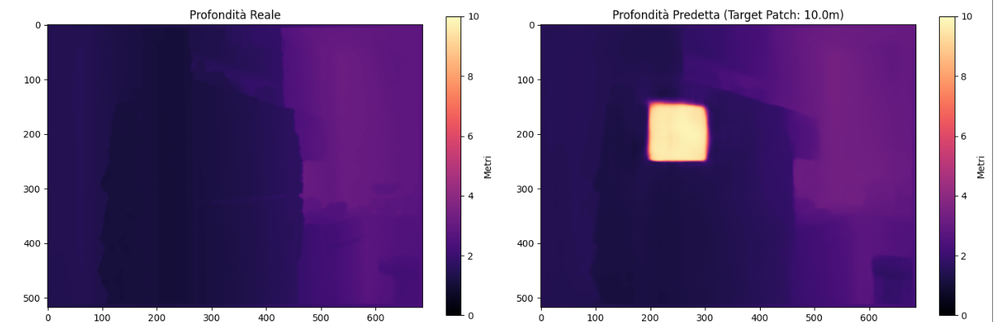

## 3.1 EOT mobile patch

In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
if ATTACCO3_1:
  # --- CONFIGURAZIONE ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (100, 100) # Larghezza, Altezza
  LEARNING_RATE = 0.03
  ITERATIONS = 1500

  # Area del Frigo (Dove la patch può muoversi e dove calcoliamo la loss)
  OBJ_X, OBJ_Y = 200, 100
  OBJ_W, OBJ_H = 250, 350

  # Limiti per il movimento della patch (deve stare dentro il frigo)
  MIN_X = OBJ_X
  MAX_X = OBJ_X + OBJ_W - PATCH_SIZE[0]
  MIN_Y = OBJ_Y
  MAX_Y = OBJ_Y + OBJ_H - PATCH_SIZE[1]

  # --- DATI ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target: Vogliamo nascondere TUTTO il frigo
  mask_object = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_object[:, :, OBJ_Y:OBJ_Y+OBJ_H, OBJ_X:OBJ_X+OBJ_W] = 1.0

  # Inizializza Patch
  adversarial_patch = torch.rand((1, 3, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)
  optimizer = optim.Adam([adversarial_patch], lr=LEARNING_RATE)

  print(f"🎯 Obiettivo: La patch si muoverà nell'area ({MIN_X}:{MAX_X}, {MIN_Y}:{MAX_Y}) per nascondere l'intero oggetto.")

  # --- TRAINING ATTACCO (PATCH MOBILE) ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # 1. Posizionamento Casuale (EOT)
      # Ad ogni iterazione, scegliamo una posizione diversa SUL FRIGO
      cur_x = random.randint(MIN_X, MAX_X)
      cur_y = random.randint(MIN_Y, MAX_Y)

      # 2. Crea la maschera della patch per questa posizione
      patch_padded = torch.zeros_like(img_tensor)
      patch_padded[:, :, cur_y:cur_y+PATCH_SIZE[1], cur_x:cur_x+PATCH_SIZE[0]] = adversarial_patch

      # Maschera per applicare la patch (solo dove si trova ora)
      mask_current_patch = torch.zeros((1, 1, H, W)).to(DEVICE)
      mask_current_patch[:, :, cur_y:cur_y+PATCH_SIZE[1], cur_x:cur_x+PATCH_SIZE[0]] = 1.0

      # 3. Applica patch all'immagine
      img_adv = img_tensor * (1 - mask_current_patch) + patch_padded * mask_current_patch

      # 4. Forward
      pred_adv = model(img_adv)
      pred_adv = torch.nn.functional.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # 5. Loss: Calcolata su TUTTO IL FRIGO (mask_object), non solo sulla patch
      pred_object_area = pred_adv * mask_object
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_object

      # Total Variation Loss (per rendere la patch meno "rumorosa" e più pattern)
      tv_loss = torch.sum(torch.abs(adversarial_patch[:, :, :, :-1] - adversarial_patch[:, :, :, 1:])) + \
                torch.sum(torch.abs(adversarial_patch[:, :, :-1, :] - adversarial_patch[:, :, 1:, :]))

      # La loss principale guida l'invisibilità, la TV loss la stampabilità
      loss = torch.nn.functional.mse_loss(pred_object_area, target_val) + 0.01 * tv_loss

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          adversarial_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- VISUALIZZAZIONE (Posizioniamo la patch al centro per il test finale) ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      # Posizioniamo la patch al centro del frigo per la foto finale
      final_x = OBJ_X + (OBJ_W - PATCH_SIZE[0]) // 2
      final_y = OBJ_Y + (OBJ_H - PATCH_SIZE[1]) // 2

      patch_padded = torch.zeros_like(img_tensor)
      patch_padded[:, :, final_y:final_y+PATCH_SIZE[1], final_x:final_x+PATCH_SIZE[0]] = adversarial_patch
      mask_final_patch = torch.zeros((1, 1, H, W)).to(DEVICE)
      mask_final_patch[:, :, final_y:final_y+PATCH_SIZE[1], final_x:final_x+PATCH_SIZE[0]] = 1.0

      img_final_adv = img_tensor * (1 - mask_final_patch) + patch_padded * mask_final_patch

      pred_final = model(img_final_adv)
      pred_final = torch.nn.functional.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear', align_corners=True)[0, 0]
      pred_final_np = pred_final.cpu().numpy()

  # Plot
  fig, axes = plt.subplots(2, 2, figsize=(15, 10))

  # RGB
  img_vis = img_tensor[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,0].imshow(img_vis); axes[0,0].set_title("Originale")

  # RGB Adv
  img_adv_vis = img_final_adv[0].permute(1, 2, 0).cpu().numpy()
  img_adv_vis = (img_adv_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_adv_vis); axes[0,1].set_title("Patch Ottimizzata (Mobile)")

  # GT
  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Profondità Reale"); plt.colorbar(im1, ax=axes[1,0])

  # Pred
  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Profondità Predetta (Effetto Globale?)"); plt.colorbar(im2, ax=axes[1,1])

  plt.tight_layout()
  plt.show()

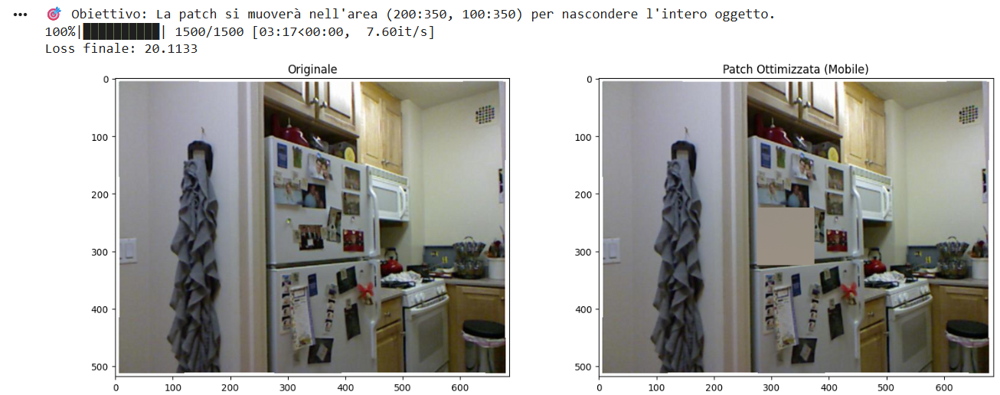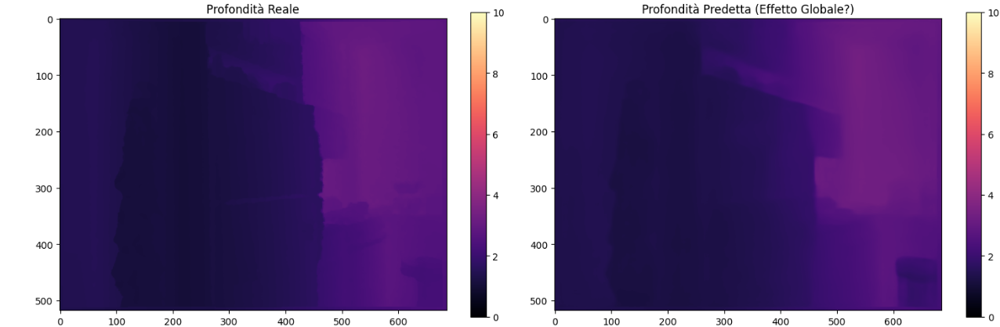

##3.2 Attacco Mirato e Aggressivo

In [ ]:
import torch
import torch.optim as optim
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
if ATTACCO3_2:
  # --- CONFIGURAZIONE AGGRESSIVA ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (150, 150) # Aumentata
  LEARNING_RATE = 0.05
  ITERATIONS = 1000

  # Centro del Frigo
  CENTER_X = 325
  CENTER_Y = 275

  # Area di movimento ristretta (Jittering)
  # La patch vibra intorno al centro invece di vagare ovunque
  JITTER_RANGE = 30

  # --- DATI ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Oggetto (Dove calcoliamo la loss) -> Ci focalizziamo  sull'area centrale
  # Invece di tutto il frigo, proviamo a "bucare" il centro in modo massiccio
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, CENTER_Y-100:CENTER_Y+100, CENTER_X-100:CENTER_X+100] = 1.0

  # Inizializza Patch
  adversarial_patch = torch.rand((1, 3, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)
  optimizer = optim.Adam([adversarial_patch], lr=LEARNING_RATE)

  print(f"🎯 Attacco Aggressivo: Patch {PATCH_SIZE} con Jittering ±{JITTER_RANGE}px.")

  # --- TRAINING ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # Jittering Casuale (EOT Locale)
      off_x = random.randint(-JITTER_RANGE, JITTER_RANGE)
      off_y = random.randint(-JITTER_RANGE, JITTER_RANGE)

      cur_x = CENTER_X - PATCH_SIZE[0]//2 + off_x
      cur_y = CENTER_Y - PATCH_SIZE[1]//2 + off_y

      # Applica Patch
      patch_padded = torch.zeros_like(img_tensor)
      patch_padded[:, :, cur_y:cur_y+PATCH_SIZE[1], cur_x:cur_x+PATCH_SIZE[0]] = adversarial_patch

      mask_current_patch = torch.zeros((1, 1, H, W)).to(DEVICE)
      mask_current_patch[:, :, cur_y:cur_y+PATCH_SIZE[1], cur_x:cur_x+PATCH_SIZE[0]] = 1.0

      img_adv = img_tensor * (1 - mask_current_patch) + patch_padded * mask_current_patch

      # Forward
      pred_adv = model(img_adv)
      pred_adv = torch.nn.functional.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # Loss: Solo MSE, niente TV Loss (Massima potenza)
      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area

      loss = torch.nn.functional.mse_loss(pred_area, target_val)

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          adversarial_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      # Posizione centrale per display
      final_x = CENTER_X - PATCH_SIZE[0]//2
      final_y = CENTER_Y - PATCH_SIZE[1]//2

      patch_padded = torch.zeros_like(img_tensor)
      patch_padded[:, :, final_y:final_y+PATCH_SIZE[1], final_x:final_x+PATCH_SIZE[0]] = adversarial_patch
      mask_final = torch.zeros((1, 1, H, W)).to(DEVICE)
      mask_final[:, :, final_y:final_y+PATCH_SIZE[1], final_x:final_x+PATCH_SIZE[0]] = 1.0

      img_final_adv = img_tensor * (1 - mask_final) + patch_padded * mask_final

      pred_final = model(img_final_adv)
      pred_final = torch.nn.functional.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear', align_corners=True)[0, 0]
      pred_final_np = pred_final.cpu().numpy()

  fig, axes = plt.subplots(2, 2, figsize=(15, 10))

  # RGB
  img_vis = img_tensor[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,0].imshow(img_vis); axes[0,0].set_title("Originale")

  # RGB Adv
  img_adv_vis = img_final_adv[0].permute(1, 2, 0).cpu().numpy()
  img_adv_vis = (img_adv_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_adv_vis); axes[0,1].set_title("Patch Aggressiva")

  # GT
  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Profondità Reale"); plt.colorbar(im1, ax=axes[1,0])

  # Pred
  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Profondità Predetta"); plt.colorbar(im2, ax=axes[1,1])

  plt.tight_layout()
  plt.show()

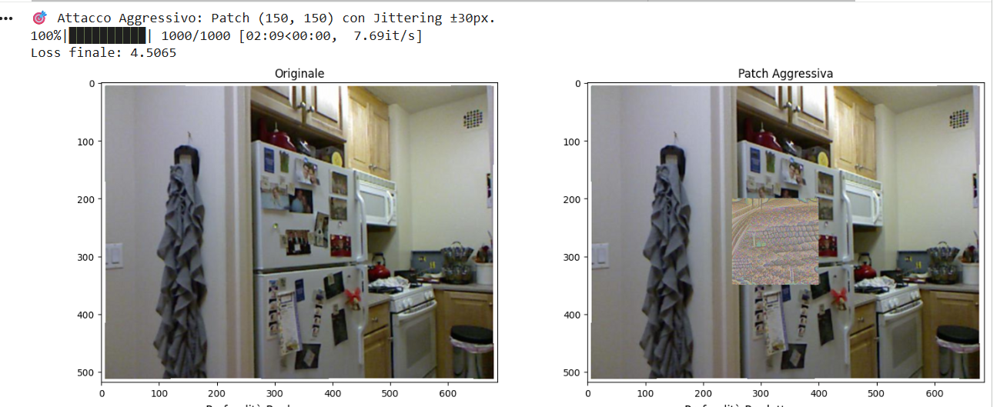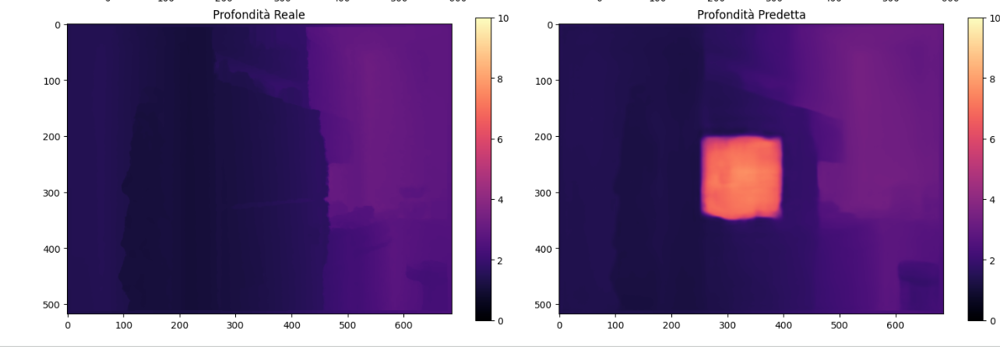

## 4.1 EOT Completo + Multi-Posizione

In [ ]:
import torch
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
import math
if ATTACCO4_1:
  # --- CONFIGURAZIONE AVANZATA ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (150, 150)
  LEARNING_RATE = 0.05
  ITERATIONS = 1500

  # Coordinate Frigo
  OBJ_X, OBJ_Y = 200, 100
  OBJ_W, OBJ_H = 250, 350

  # PUNTI DI ATTACCO
  POS_1 = (325, 275) # Centro
  POS_2 = (325, 150) # Alto

  # --- DATI ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, OBJ_Y:OBJ_Y+OBJ_H, OBJ_X:OBJ_X+OBJ_W] = 1.0

  # Patch
  adversarial_patch = torch.rand((1, 3, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)
  optimizer = optim.Adam([adversarial_patch], lr=LEARNING_RATE)

  # --- FUNZIONE EOT ---
  def apply_random_transform(patch_tensor, device):
      angle = random.uniform(-20, 20) * (math.pi / 180.0)
      scale = random.uniform(0.8, 1.2)

      theta = torch.tensor([
          [math.cos(angle) / scale, -math.sin(angle) / scale, 0],
          [math.sin(angle) / scale, math.cos(angle) / scale, 0]
      ], dtype=torch.float, device=device).unsqueeze(0)

      grid = F.affine_grid(theta, patch_tensor.size(), align_corners=False)
      transformed_patch = F.grid_sample(patch_tensor, grid, align_corners=False, padding_mode='zeros')

      mask_ones = torch.ones_like(patch_tensor)
      transformed_mask = F.grid_sample(mask_ones, grid, align_corners=False, padding_mode='zeros')
      transformed_mask = (transformed_mask > 0.5).float()

      return transformed_patch, transformed_mask

  print(f"🎯 Attacco EOT Avanzato: Rotazione, Scala e Doppia Posizione (FIXED).")

  # --- TRAINING ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # 1. Trasforma la patch
      trans_patch, trans_mask = apply_random_transform(adversarial_patch, DEVICE)

      # 2. Posizionamento
      patches_list = []
      masks_list = []

      # Aggiungiamo un "canvas vuoto" di base alla lista per evitare errori se la lista fosse vuota
      patches_list.append(torch.zeros_like(img_tensor))
      masks_list.append(torch.zeros_like(img_tensor))

      for center_x, center_y in [POS_1, POS_2]:
          jx = center_x + random.randint(-10, 10)
          jy = center_y + random.randint(-10, 10)

          y1 = jy - PATCH_SIZE[1]//2
          y2 = y1 + PATCH_SIZE[1]
          x1 = jx - PATCH_SIZE[0]//2
          x2 = x1 + PATCH_SIZE[0]

          if y1 < 0 or x1 < 0 or y2 > H or x2 > W: continue

          # Creiamo un canvas temporaneo SOLO per questa patch
          temp_patch_canvas = torch.zeros_like(img_tensor)
          temp_mask_canvas = torch.zeros_like(img_tensor)

          # Assegniamo la patch al canvas temporaneo
          temp_patch_canvas[:, :, y1:y2, x1:x2] = trans_patch
          temp_mask_canvas[:, :, y1:y2, x1:x2] = trans_mask

          patches_list.append(temp_patch_canvas)
          masks_list.append(temp_mask_canvas)

      # 3. Uniamo tutto usando MAX (operazione sicura per il gradiente)
      # Stackiamo tutti i canvas [N, 3, H, W] e prendiamo il max lungo la dimensione N
      patch_canvas = torch.stack(patches_list).max(dim=0)[0]
      mask_canvas = torch.stack(masks_list).max(dim=0)[0]

      # 4. Combina
      img_adv = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas

      # Noise
      noise = torch.randn_like(img_adv) * 0.02
      img_adv = (img_adv + noise).clamp(0, 1)

      # 5. Forward & Loss
      pred_adv = model(img_adv)
      pred_adv = F.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area

      loss = F.mse_loss(pred_area, target_val)

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          adversarial_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      # Ricostruzione pulita per plot
      patches_list = [torch.zeros_like(img_tensor)]
      masks_list = [torch.zeros_like(img_tensor)]

      for center_x, center_y in [POS_1, POS_2]:
          y1, y2 = center_y - PATCH_SIZE[1]//2, center_y + PATCH_SIZE[1]//2
          x1, x2 = center_x - PATCH_SIZE[0]//2, center_x + PATCH_SIZE[0]//2

          temp_p = torch.zeros_like(img_tensor)
          temp_m = torch.zeros_like(img_tensor)
          temp_p[:, :, y1:y2, x1:x2] = adversarial_patch
          temp_m[:, :, y1:y2, x1:x2] = 1.0

          patches_list.append(temp_p)
          masks_list.append(temp_m)

      patch_canvas = torch.stack(patches_list).max(dim=0)[0]
      mask_canvas = torch.stack(masks_list).max(dim=0)[0]

      img_final_adv = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas
      pred_final = model(img_final_adv)
      pred_final = F.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear', align_corners=True)[0, 0]
      pred_final_np = pred_final.cpu().numpy()

  # Plot
  fig, axes = plt.subplots(2, 2, figsize=(15, 10))

  img_vis = img_tensor[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,0].imshow(img_vis); axes[0,0].set_title("Originale")

  img_adv_vis = img_final_adv[0].permute(1, 2, 0).cpu().numpy()
  img_adv_vis = (img_adv_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_adv_vis); axes[0,1].set_title("Attacco Multi-Patch EOT")

  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Profondità Reale"); plt.colorbar(im1, ax=axes[1,0])

  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Profondità Predetta"); plt.colorbar(im2, ax=axes[1,1])

  plt.tight_layout()
  plt.show()

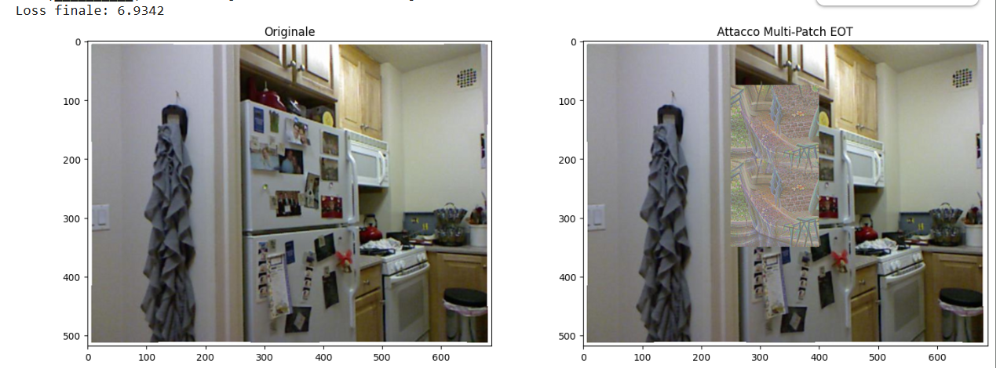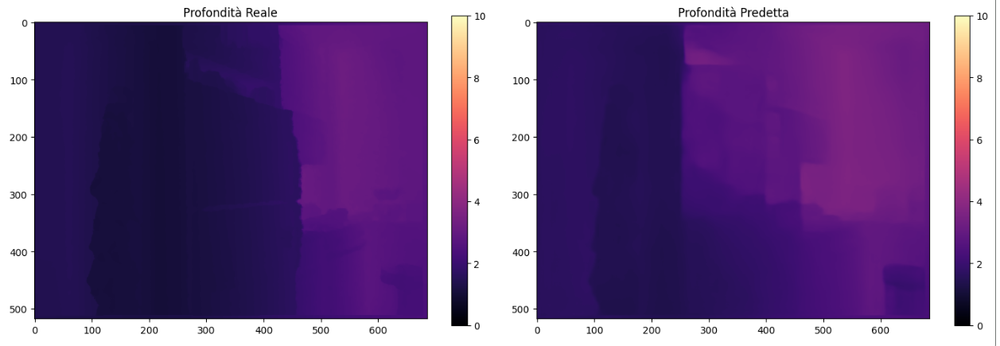

  ## 5.1 'Physical Ready': EOT + NPS + TV Loss

In [ ]:
if ATTACCO5_1:

  # --- CONFIGURAZIONE EXP 3.4 (Physical Ready) ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (150, 150)
  LEARNING_RATE = 0.03
  ITERATIONS = 1000

  # Pesi delle Loss (Bilanciamento delicato!)
  W_MSE = 1.0    # Priorità all'attacco
  W_NPS = 0.01   # Penalità per colori non stampabili
  W_TV  = 0.05   # Penalità per rumore eccessivo (lisciare la patch)

  # Inizializza Loss
  nps_calculator = NonPrintabilityScore(device=DEVICE)

  # Coordinate Frigo
  OBJ_X, OBJ_Y = 200, 100
  OBJ_W, OBJ_H = 250, 350

  # PUNTI DI ATTACCO
  POS_1 = (325, 275) # Centro
  POS_2 = (325, 150) # Alto

  # --- DATI ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, OBJ_Y:OBJ_Y+OBJ_H, OBJ_X:OBJ_X+OBJ_W] = 1.0

  # Patch
  adversarial_patch = torch.rand((1, 3, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)
  optimizer = optim.Adam([adversarial_patch], lr=LEARNING_RATE)

  # --- FUNZIONE EOT ---
  def apply_random_transform(patch_tensor, device):
      angle = random.uniform(-20, 20) * (math.pi / 180.0)
      scale = random.uniform(0.8, 1.2)

      theta = torch.tensor([
          [math.cos(angle) / scale, -math.sin(angle) / scale, 0],
          [math.sin(angle) / scale, math.cos(angle) / scale, 0]
      ], dtype=torch.float, device=device).unsqueeze(0)

      grid = F.affine_grid(theta, patch_tensor.size(), align_corners=False)
      transformed_patch = F.grid_sample(patch_tensor, grid, align_corners=False, padding_mode='zeros')

      mask_ones = torch.ones_like(patch_tensor)
      transformed_mask = F.grid_sample(mask_ones, grid, align_corners=False, padding_mode='zeros')
      transformed_mask = (transformed_mask > 0.5).float()

      return transformed_patch, transformed_mask

  print(f"🎯 Attacco 'Physical Ready': EOT + NPS + TV Loss.")

  # --- TRAINING LOOP ---
  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

          # 1. Trasforma la patch
      trans_patch, trans_mask = apply_random_transform(adversarial_patch, DEVICE)

      # 2. Posizionamento
      patches_list = []
      masks_list = []

      # Aggiungiamo un "canvas vuoto" di base alla lista per evitare errori se la lista fosse vuota
      patches_list.append(torch.zeros_like(img_tensor))
      masks_list.append(torch.zeros_like(img_tensor))

      for center_x, center_y in [POS_1, POS_2]:
          jx = center_x + random.randint(-10, 10)
          jy = center_y + random.randint(-10, 10)

          y1 = jy - PATCH_SIZE[1]//2
          y2 = y1 + PATCH_SIZE[1]
          x1 = jx - PATCH_SIZE[0]//2
          x2 = x1 + PATCH_SIZE[0]

          if y1 < 0 or x1 < 0 or y2 > H or x2 > W: continue

          # Creiamo un canvas temporaneo SOLO per questa patch
          temp_patch_canvas = torch.zeros_like(img_tensor)
          temp_mask_canvas = torch.zeros_like(img_tensor)

          # Assegniamo la patch al canvas temporaneo (questo è ok)
          temp_patch_canvas[:, :, y1:y2, x1:x2] = trans_patch
          temp_mask_canvas[:, :, y1:y2, x1:x2] = trans_mask

          patches_list.append(temp_patch_canvas)
          masks_list.append(temp_mask_canvas)

      # 3. Uniamo tutto usando MAX (operazione sicura per il gradiente)
      # Stackiamo tutti i canvas [N, 3, H, W] e prendiamo il max lungo la dimensione N
      patch_canvas = torch.stack(patches_list).max(dim=0)[0]
      mask_canvas = torch.stack(masks_list).max(dim=0)[0]

      # 4. Combina
      img_adv = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas

      # Noise
      noise = torch.randn_like(img_adv) * 0.02
      img_adv = (img_adv + noise).clamp(0, 1)

      # 1. Forward
      pred_adv = model(img_adv)
      pred_adv = F.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # 2. Calcolo Loss Composita

      # A. MSE Loss (L'attacco vero e proprio)
      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area
      mse_loss = F.mse_loss(pred_area, target_val)

      # B. NPS Loss (Stampabilità)
      nps_loss = nps_calculator(adversarial_patch)

      # C. TV Loss (Smoothness)
      # Calcola la differenza tra pixel adiacenti
      tv_loss = torch.sum(torch.abs(adversarial_patch[:, :, :, :-1] - adversarial_patch[:, :, :, 1:])) + \
                torch.sum(torch.abs(adversarial_patch[:, :, :-1, :] - adversarial_patch[:, :, 1:, :]))

      # Somma Pesata
      loss = (W_MSE * mse_loss) + (W_NPS * nps_loss) + (W_TV * tv_loss)

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          adversarial_patch.data.clamp_(0, 1)

      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      patches_list = [torch.zeros_like(img_tensor)]
      masks_list = [torch.zeros_like(img_tensor)]

      for center_x, center_y in [POS_1, POS_2]:
          y1, y2 = center_y - PATCH_SIZE[1]//2, center_y + PATCH_SIZE[1]//2
          x1, x2 = center_x - PATCH_SIZE[0]//2, center_x + PATCH_SIZE[0]//2

          temp_p = torch.zeros_like(img_tensor)
          temp_m = torch.zeros_like(img_tensor)
          temp_p[:, :, y1:y2, x1:x2] = adversarial_patch
          temp_m[:, :, y1:y2, x1:x2] = 1.0

          patches_list.append(temp_p)
          masks_list.append(temp_m)

      patch_canvas = torch.stack(patches_list).max(dim=0)[0]
      mask_canvas = torch.stack(masks_list).max(dim=0)[0]

      img_final_adv = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas
      pred_final = model(img_final_adv)
      pred_final = F.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear', align_corners=True)[0, 0]
      pred_final_np = pred_final.cpu().numpy()

  # Plot
  fig, axes = plt.subplots(2, 2, figsize=(15, 10))

  img_vis = img_tensor[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,0].imshow(img_vis); axes[0,0].set_title("Originale")

  img_adv_vis = img_final_adv[0].permute(1, 2, 0).cpu().numpy()
  img_adv_vis = (img_adv_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_adv_vis); axes[0,1].set_title("Attacco Multi-Patch EOT")

  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Profondità Reale"); plt.colorbar(im1, ax=axes[1,0])

  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Profondità Predetta"); plt.colorbar(im2, ax=axes[1,1])

  plt.tight_layout()
  plt.show()

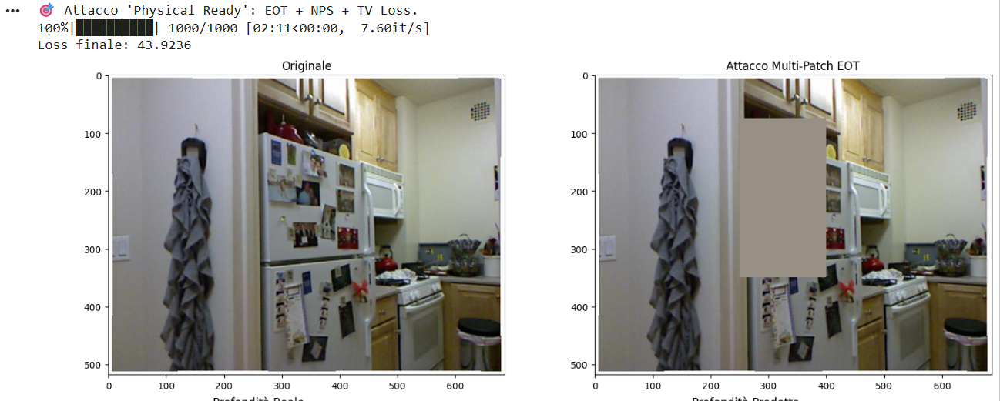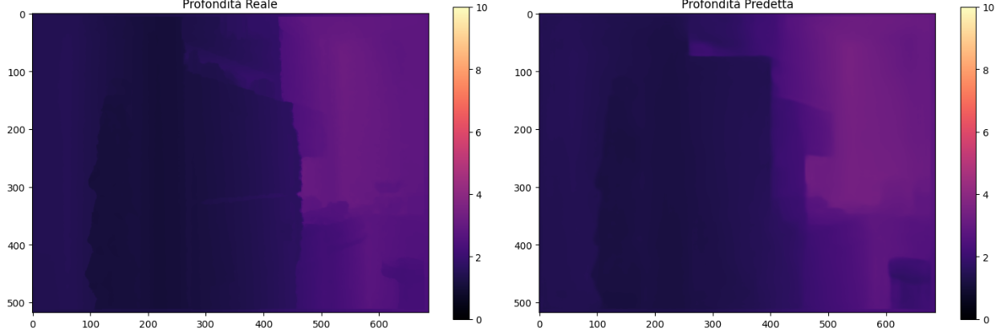

## 5.2 B&W Binary Attack

In [ ]:
import torch
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
import math

if ATTACCO5_2:
  # --- CONFIGURAZIONE B&W ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (150, 150)
  LEARNING_RATE = 0.05 # Aggressivo
  ITERATIONS = 1000

  # Posizioni (Strategia Multi-Patch che funzionava bene)
  POS_1 = (325, 275)
  POS_2 = (325, 150)

  # Pesi Loss
  W_MSE = 1.0
  W_BINARY = 0.05  # Spinge i pixel verso 0 o 1 (Bianco/Nero)

  # --- SETUP ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target Globale
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, OBJ_Y:OBJ_Y+OBJ_H, OBJ_X:OBJ_X+OBJ_W] = 1.0

  # --- PATCH B&W ---
  # Inizializziamo 1 solo canale (Grayscale)
  grayscale_patch = torch.rand((1, 1, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)

  optimizer = optim.Adam([grayscale_patch], lr=LEARNING_RATE)

  # Funzione Trasformazione EOT (uguale a prima)
  def apply_random_transform(patch_tensor, device):
      angle = random.uniform(-15, 15) * (math.pi / 180.0) # Rotazione leggera
      scale = random.uniform(0.9, 1.1)
      theta = torch.tensor([
          [math.cos(angle) / scale, -math.sin(angle) / scale, 0],
          [math.sin(angle) / scale, math.cos(angle) / scale, 0]
      ], dtype=torch.float, device=device).unsqueeze(0)
      grid = F.affine_grid(theta, patch_tensor.size(), align_corners=False)
      t_patch = F.grid_sample(patch_tensor, grid, align_corners=False, padding_mode='border') # Border per evitare bordi neri
      return t_patch

  print(f"🎯 Attacco 'B&W High Contrast': Ottimizzazione Binaria.")

  # --- TRAINING ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # 1. Converti Grayscale -> RGB (Il modello vuole 3 canali)
      # Basta ripetere il canale grigio 3 volte
      rgb_patch = grayscale_patch.repeat(1, 3, 1, 1)

      # 2. EOT Transform
      trans_patch = apply_random_transform(rgb_patch, DEVICE)

      # 3. Posizionamento (Accumulo sicuro)
      # (Logica sicura per evitare errori in-place)
      final_patch_canvas = torch.zeros_like(img_tensor)
      final_mask_canvas = torch.zeros_like(img_tensor)

      # Usiamo posizioni fisse per semplicità nel loop, ma con trasformazione EOT applicata alla patch
      for center_x, center_y in [POS_1, POS_2]:
          # Piccolo jitter
          jx, jy = center_x + random.randint(-5, 5), center_y + random.randint(-5, 5)

          y1, y2 = jy - PATCH_SIZE[1]//2, jy + PATCH_SIZE[1]//2
          x1, x2 = jx - PATCH_SIZE[0]//2, jx + PATCH_SIZE[0]//2

          # Creiamo maschera locale
          local_mask = torch.zeros_like(img_tensor)
          local_mask[:, :, y1:y2, x1:x2] = 1.0

          # Piazziamo la patch trasformata nel canvas
          final_patch_canvas[:, :, y1:y2, x1:x2] = trans_patch
          final_mask_canvas = torch.max(final_mask_canvas, local_mask)

      # 4. Composizione
      img_adv = img_tensor * (1 - final_mask_canvas) + final_patch_canvas * final_mask_canvas

      # 5. Forward
      pred_adv = model(img_adv)
      pred_adv = F.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # 6. LOSSES
      # A. Attacco (MSE)
      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area
      mse_loss = F.mse_loss(pred_area, target_val)

      # B. Binary Loss (Spinge verso Bianco o Nero)
      # Formula: p * (1 - p). È 0 se p=0 o p=1. È max (0.25) se p=0.5 (grigio)
      binary_loss = torch.mean(grayscale_patch * (1 - grayscale_patch))

      loss = W_MSE * mse_loss + W_BINARY * binary_loss

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          grayscale_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  print(f"Loss finale: {losses[-1]:.4f}")


  with torch.no_grad():
      # Ricostruzione finale pulita
      rgb_patch_final = grayscale_patch.repeat(1, 3, 1, 1)
      patch_canvas = torch.zeros_like(img_tensor)
      mask_canvas = torch.zeros_like(img_tensor)

      for center_x, center_y in [POS_1, POS_2]:
          y1, y2 = center_y - PATCH_SIZE[1]//2, center_y + PATCH_SIZE[1]//2
          x1, x2 = center_x - PATCH_SIZE[0]//2, center_x + PATCH_SIZE[0]//2
          patch_canvas[:, :, y1:y2, x1:x2] = rgb_patch_final
          mask_canvas[:, :, y1:y2, x1:x2] = 1.0

      img_final = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas
      pred_final = model(img_final)
      pred_final = F.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear')[0, 0].cpu().numpy()

  # Plot Risultati
  fig, axes = plt.subplots(2, 2, figsize=(12, 10))

  # 1. Patch da stampare (Zoom)
  patch_np = grayscale_patch[0, 0].detach().cpu().numpy()

  axes[0,0].imshow(patch_np, cmap='gray', vmin=0, vmax=1)
  axes[0,0].set_title("PATCH DA STAMPARE (B&W)")
  axes[0,0].axis('off')

  # 2. Immagine Attaccata
  img_vis = img_final[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_vis)
  axes[0,1].set_title("Simulazione Digitale")
  axes[0,1].axis('off')

  # 3. Depth Originale
  axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Depth Reale")

  # 4. Depth Predetta
  axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Depth Predetta")

  plt.tight_layout()
  plt.show()

  # Salva la patch per la stampa
  plt.imsave("patch_bw_print.png", patch_np, cmap='gray')
  print("💾 Patch salvata come 'patch_bw_print.png'. Scaricala e stampala!")

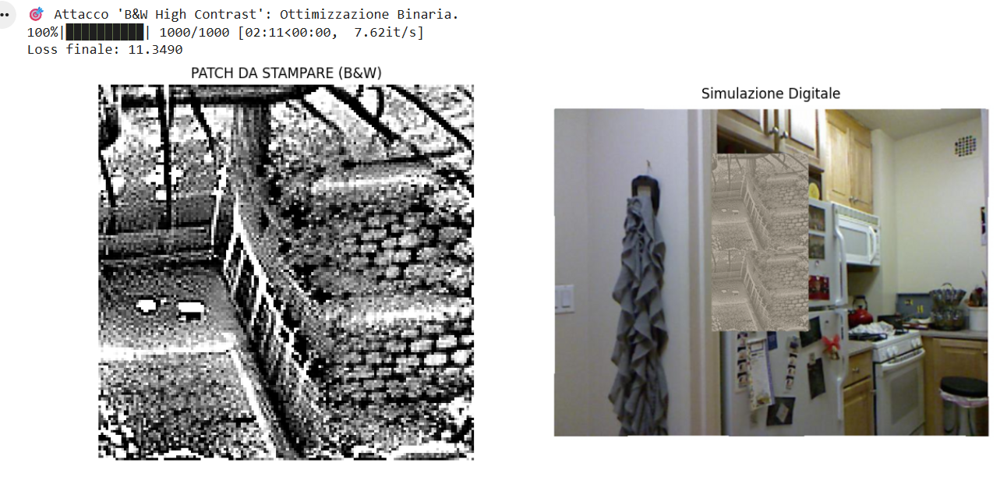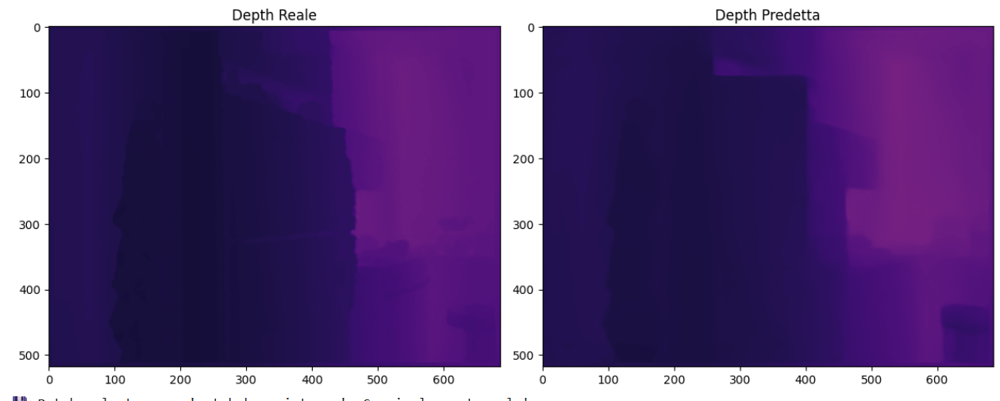

## 5.3 "Context Breaking" (4-Patch Mosaic)

In [ ]:
import torch
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
import math
if ATTACCO5_3:
  # --- CONFIGURAZIONE ESTREMA ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (120, 120) # Un po' più piccole ma sono 4
  LEARNING_RATE = 0.1     # Molto aggressivo all'inizio
  ITERATIONS = 1500

  # Coordinate Frigo
  OBJ_X, OBJ_Y = 200, 100
  OBJ_W, OBJ_H = 250, 350

  # DEFINIAMO 4 PUNTI (A SCACCHIERA)
  # Copriamo i 4 quadranti del frigo per rompere la geometria
  POSITIONS = [
      (275, 180), # Alto Sinistra
      (375, 180), # Alto Destra
      (275, 300), # Basso Sinistra
      (375, 300)  # Basso Destra
  ]

  # --- SETUP ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target Globale (Tutto il frigo)
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, OBJ_Y:OBJ_Y+OBJ_H, OBJ_X:OBJ_X+OBJ_W] = 1.0

  # --- PATCH LATENTE ---
  # Non ottimizziamo direttamente i pixel [0,1], ma un valore latente "raw"
  # Questo ci permette di usare una sigmoide per forzare il B&W
  patch_latent = torch.randn((1, 1, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)

  optimizer = optim.Adam([patch_latent], lr=LEARNING_RATE)

  # Funzione EOT (uguale a prima)
  def apply_random_transform(patch_tensor, device):
      angle = random.uniform(-10, 10) * (math.pi / 180.0)
      scale = random.uniform(0.9, 1.1)
      theta = torch.tensor([
          [math.cos(angle) / scale, -math.sin(angle) / scale, 0],
          [math.sin(angle) / scale, math.cos(angle) / scale, 0]
      ], dtype=torch.float, device=device).unsqueeze(0)
      grid = F.affine_grid(theta, patch_tensor.size(), align_corners=False)
      return F.grid_sample(patch_tensor, grid, align_corners=False, padding_mode='border')

  print(f"🎯 Attacco 'Context Breaking': 4-Patch Mosaic con B&W Forzato.")

  # --- TRAINING ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # 1. GENERAZIONE PATCH B&W (Hardening)
      # Aumentiamo la "ripidezza" della sigmoide nel tempo per forzare bianco/nero puro
      # All'inizio è grigia, alla fine è binaria netta.
      temperature = 1 + (i / ITERATIONS) * 10  # Sale da 1 a 11
      binary_patch = torch.sigmoid(patch_latent * temperature)

      # Converti a 3 canali per il modello
      rgb_patch = binary_patch.repeat(1, 3, 1, 1)

      # 2. EOT Transform
      trans_patch = apply_random_transform(rgb_patch, DEVICE)

      # 3. Posizionamento (Accumulo sicuro 4 patch)
      final_patch_canvas = torch.zeros_like(img_tensor)
      final_mask_canvas = torch.zeros_like(img_tensor)

      # Per ogni posizione applichiamo un leggero jitter indipendente
      for center_x, center_y in POSITIONS:
          jx = center_x + random.randint(-5, 5)
          jy = center_y + random.randint(-5, 5)

          y1, y2 = jy - PATCH_SIZE[1]//2, jy + PATCH_SIZE[1]//2
          x1, x2 = jx - PATCH_SIZE[0]//2, jx + PATCH_SIZE[0]//2

          # Controlli boundary base
          if y1 < 0 or x1 < 0 or y2 > H or x2 > W: continue

          # Costruisci maschera locale
          local_mask = torch.zeros_like(img_tensor)
          local_mask[:, :, y1:y2, x1:x2] = 1.0

          # Incolla (usando Max per gestire sovrapposizioni in modo pulito)

          final_patch_canvas[:, :, y1:y2, x1:x2] = trans_patch
          final_mask_canvas = torch.max(final_mask_canvas, local_mask)

      # 4. Composizione
      img_adv = img_tensor * (1 - final_mask_canvas) + final_patch_canvas * final_mask_canvas

      # 5. Forward
      pred_adv = model(img_adv)
      pred_adv = F.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # 6. LOSSES
      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area

      # Loss Principale (MSE)
      mse_loss = F.mse_loss(pred_area, target_val)

      # Loss Binaria "Extra" (per pulire i grigi residui)
      # Penalizza valori vicini a 0.5
      p = binary_patch
      bin_loss = torch.mean(p * (1 - p))

      loss = mse_loss + 0.1 * bin_loss

      loss.backward()
      optimizer.step()

      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      # Generazione patch finale binaria pulita (Hard Threshold)
      final_patch_bw = (patch_latent > 0).float() # 0 o 1 puro
      rgb_patch_final = final_patch_bw.repeat(1, 3, 1, 1)

      patch_canvas = torch.zeros_like(img_tensor)
      mask_canvas = torch.zeros_like(img_tensor)

      for cx, cy in POSITIONS:
          y1, y2 = cy - PATCH_SIZE[1]//2, cy + PATCH_SIZE[1]//2
          x1, x2 = cx - PATCH_SIZE[0]//2, cx + PATCH_SIZE[0]//2
          # Safe assignment
          if y2 <= H and x2 <= W:
              patch_canvas[:, :, y1:y2, x1:x2] = rgb_patch_final
              mask_canvas[:, :, y1:y2, x1:x2] = 1.0

      img_final = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas
      pred_final = model(img_final)
      pred_final = F.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear')[0, 0].cpu().numpy()

  # Plot Risultati
  fig, axes = plt.subplots(2, 2, figsize=(14, 10))

  # 1. Patch da stampare
  patch_np = final_patch_bw[0, 0].cpu().numpy()
  axes[0,0].imshow(patch_np, cmap='gray', vmin=0, vmax=1)
  axes[0,0].set_title("PATCH FINALE (Bianco/Nero Puro)")
  axes[0,0].axis('off')

  # 2. Scena Attaccata
  img_vis = img_final[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_vis)
  axes[0,1].set_title("Scena con 4 Patch")
  axes[0,1].axis('off')

  # 3. Depth Originale
  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Depth Reale"); fig.colorbar(im1, ax=axes[1,0], label='Metri')

  # 4. Depth Predetta
  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Depth Predetta (Attacco Mosaico)"); fig.colorbar(im2, ax=axes[1,1], label='Metri')

  plt.tight_layout()
  plt.show()

  # Salva
  plt.imsave("patch_mosaic_bw.png", patch_np, cmap='gray')
  print("💾 Patch salvata come 'patch_mosaic_bw.png'.")

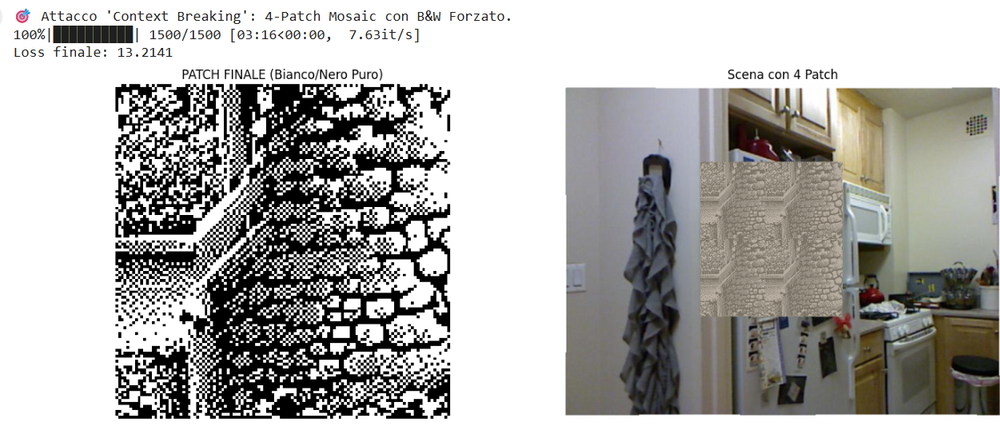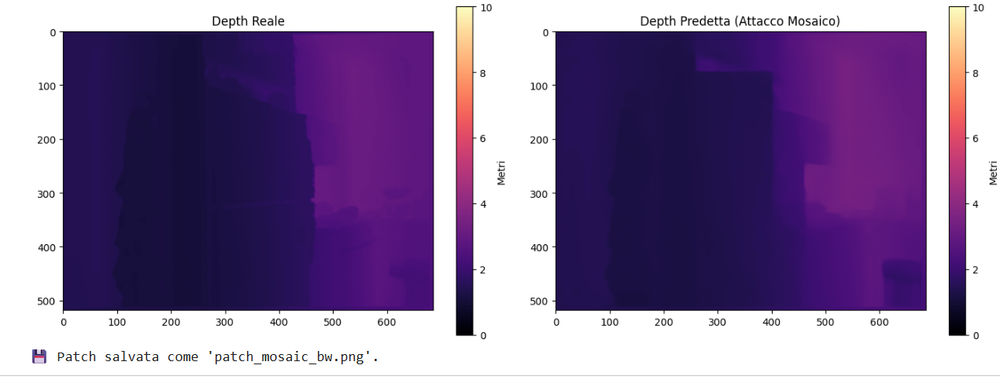

## 5.4 Aggressive Grayscale Multi-Patch

In [ ]:
import torch
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
import math


if ATTACCO5_4:
  # --- CONFIGURAZIONE "GRAYSCALE POWER" ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (150, 150)
  LEARNING_RATE = 0.05
  ITERATIONS = 1500

  # POSIZIONI STRATEGICHE
  POS_1 = (325, 275) # Centro
  POS_2 = (325, 150) # Alto (per rompere la verticalità)

  # --- SETUP ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target Globale (Tutto il frigo deve sparire)
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, OBJ_Y:OBJ_Y+OBJ_H, OBJ_X:OBJ_X+OBJ_W] = 1.0

  # --- PATCH GRAYSCALE ---
  # Inizializziamo 1 solo canale, ma senza vincoli binari.
  # Lasciamo che i valori fluttuino liberamente tra 0 e 1.
  grayscale_patch = torch.rand((1, 1, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)

  optimizer = optim.Adam([grayscale_patch], lr=LEARNING_RATE)

  # Funzione EOT (Rotazione + Scala)
  def apply_random_transform(patch_tensor, device):
      angle = random.uniform(-20, 20) * (math.pi / 180.0)
      scale = random.uniform(0.85, 1.15)

      theta = torch.tensor([
          [math.cos(angle) / scale, -math.sin(angle) / scale, 0],
          [math.sin(angle) / scale, math.cos(angle) / scale, 0]
      ], dtype=torch.float, device=device).unsqueeze(0)

      grid = F.affine_grid(theta, patch_tensor.size(), align_corners=False)
      # Padding border ripete il bordo, utile per non avere cornici nere nette
      return F.grid_sample(patch_tensor, grid, align_corners=False, padding_mode='border')

  print(f"🎯 Attacco 3.6: Grayscale Multi-Patch (Ottimizzato per Stampa B&N).")

  # --- TRAINING LOOP ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      # 1. Espansione RGB (La rete vuole 3 canali, noi ne abbiamo 1)
      # Copiamo il canale grigio su R, G e B.
      patch_rgb = grayscale_patch.repeat(1, 3, 1, 1)

      # 2. Trasformazione EOT (Applicata alla patch RGB)
      trans_patch = apply_random_transform(patch_rgb, DEVICE)

      # 3. Posizionamento (Accumulo sicuro su canvas)
      final_patch_canvas = torch.zeros_like(img_tensor)
      final_mask_canvas = torch.zeros_like(img_tensor)

      for center_x, center_y in [POS_1, POS_2]:
          # Jittering (Spostamento casuale locale)
          jx = center_x + random.randint(-10, 10)
          jy = center_y + random.randint(-10, 10)

          y1, y2 = jy - PATCH_SIZE[1]//2, jy + PATCH_SIZE[1]//2
          x1, x2 = jx - PATCH_SIZE[0]//2, jx + PATCH_SIZE[0]//2

          if y1 < 0 or x1 < 0 or y2 > H or x2 > W: continue

          # Maschera locale
          local_mask = torch.zeros_like(img_tensor)
          local_mask[:, :, y1:y2, x1:x2] = 1.0

          # Assegnazione (Semplificata per velocità, assumendo patch dentro i bordi)
          final_patch_canvas[:, :, y1:y2, x1:x2] = trans_patch
          final_mask_canvas = torch.max(final_mask_canvas, local_mask)

      # 4. Composizione Immagine
      img_adv = img_tensor * (1 - final_mask_canvas) + final_patch_canvas * final_mask_canvas

      # Aggiungiamo rumore casuale per simulare la "grana" della stampa/foto
      noise = torch.randn_like(img_adv) * 0.03
      img_adv = (img_adv + noise).clamp(0, 1)

      # 5. Forward
      pred_adv = model(img_adv)
      pred_adv = F.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # 6. Loss (Solo MSE, massima potenza)
      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area

      loss = F.mse_loss(pred_area, target_val)

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          grayscale_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- RISULTATI E SALVATAGGIO ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      # Ricostruzione finale per visualizzazione
      patch_rgb_final = grayscale_patch.repeat(1, 3, 1, 1)
      patch_canvas = torch.zeros_like(img_tensor)
      mask_canvas = torch.zeros_like(img_tensor)

      for cx, cy in [POS_1, POS_2]:
          y1, y2 = cy - PATCH_SIZE[1]//2, cy + PATCH_SIZE[1]//2
          x1, x2 = cx - PATCH_SIZE[0]//2, cx + PATCH_SIZE[0]//2
          if y2 <= H and x2 <= W:
              patch_canvas[:, :, y1:y2, x1:x2] = patch_rgb_final
              mask_canvas[:, :, y1:y2, x1:x2] = 1.0

      img_final = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas
      pred_final = model(img_final)
      pred_final = F.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear')[0, 0].cpu().numpy()

  # PLOT
  fig, axes = plt.subplots(2, 2, figsize=(14, 10))

  # 1. Patch Grayscale
  patch_np = grayscale_patch[0, 0].detach().cpu().numpy()
  axes[0,0].imshow(patch_np, cmap='gray', vmin=0, vmax=1)
  axes[0,0].set_title("PATCH GRAYSCALE (Salvataggio...)")
  axes[0,0].axis('off')

  # 2. Scena
  img_vis = img_final[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_vis)
  axes[0,1].set_title("Simulazione Attacco (B&N)")
  axes[0,1].axis('off')

  # 3. Depth Reale
  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Depth Reale"); fig.colorbar(im1, ax=axes[1,0])

  # 4. Depth Predetta
  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Depth Predetta (Grayscale EOT)"); fig.colorbar(im2, ax=axes[1,1])

  plt.tight_layout()
  plt.show()

  # Salva
  plt.imsave("patch_grayscale_final.png", patch_np, cmap='gray')
  print("💾 Patch salvata come 'patch_grayscale_final.png'.")
  print("👉 ISTRUZIONI: Stampala 2 volte. Attaccala al centro e in alto sull'oggetto.")

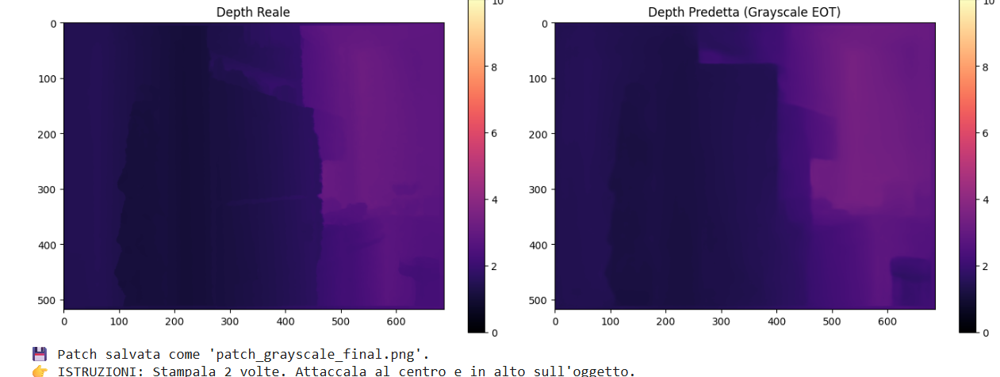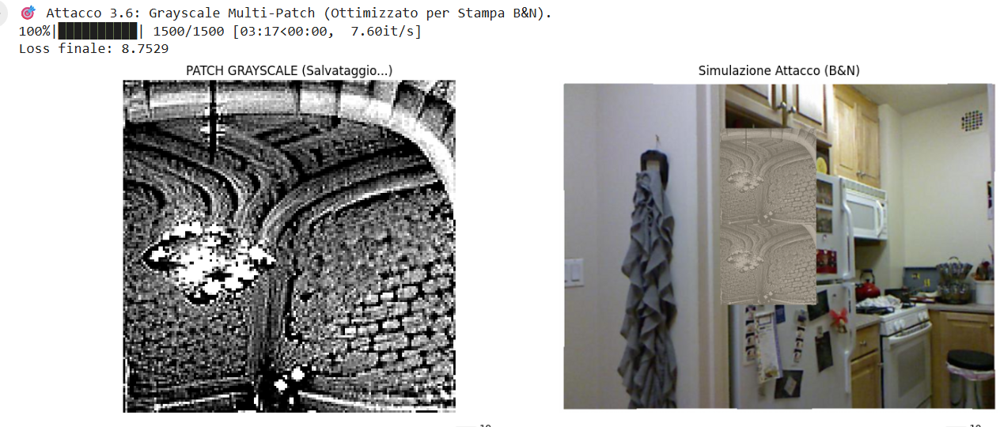

## 5.5 "Centered Grayscale Attack"

In [ ]:
import torch
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
import math

if ATTACCO5_5 :
  # --- CONFIGURAZIONE "SNIPER" ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (150, 150)
  LEARNING_RATE = 0.05
  ITERATIONS = 1500

  # NUOVE POSIZIONI (Centrate e sicure)
  # X=320 è circa l'asse centrale verticale del frigo
  POS_ALTO  = (320, 230) # Centro sportello superiore
  POS_BASSO = (320, 390) # Centro sportello inferiore

  # Jittering leggermente ridotto per garantire di restare "in sagoma"
  JITTER_RANGE = 20

  # --- SETUP ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target: Tutta la colonna del frigo
  # (Stringiamo un po' la maschera target ai lati per concentrare l'errore al centro)
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, 150:480, 250:400] = 1.0

  # --- PATCH GRAYSCALE ---
  grayscale_patch = torch.rand((1, 1, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)
  optimizer = optim.Adam([grayscale_patch], lr=LEARNING_RATE)

  # Funzione EOT
  def apply_random_transform(patch_tensor, device):
      angle = random.uniform(-15, 15) * (math.pi / 180.0) # Rotazione meno estrema
      scale = random.uniform(0.9, 1.1)

      theta = torch.tensor([
          [math.cos(angle) / scale, -math.sin(angle) / scale, 0],
          [math.sin(angle) / scale, math.cos(angle) / scale, 0]
      ], dtype=torch.float, device=device).unsqueeze(0)

      grid = F.affine_grid(theta, patch_tensor.size(), align_corners=False)
      return F.grid_sample(patch_tensor, grid, align_corners=False, padding_mode='border')

  print(f"🎯 Attacco 3.7: Centered Grayscale (Posizionamento Corretto).")

  # --- TRAINING LOOP ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      patch_rgb = grayscale_patch.repeat(1, 3, 1, 1)
      trans_patch = apply_random_transform(patch_rgb, DEVICE)

      final_patch_canvas = torch.zeros_like(img_tensor)
      final_mask_canvas = torch.zeros_like(img_tensor)

      # Usiamo le nuove posizioni
      for center_x, center_y in [POS_ALTO, POS_BASSO]:
          jx = center_x + random.randint(-JITTER_RANGE, JITTER_RANGE)
          jy = center_y + random.randint(-JITTER_RANGE, JITTER_RANGE)

          y1, y2 = jy - PATCH_SIZE[1]//2, jy + PATCH_SIZE[1]//2
          x1, x2 = jx - PATCH_SIZE[0]//2, jx + PATCH_SIZE[0]//2

          if y1 < 0 or x1 < 0 or y2 > H or x2 > W: continue

          local_mask = torch.zeros_like(img_tensor)
          local_mask[:, :, y1:y2, x1:x2] = 1.0

          final_patch_canvas[:, :, y1:y2, x1:x2] = trans_patch
          final_mask_canvas = torch.max(final_mask_canvas, local_mask)

      img_adv = img_tensor * (1 - final_mask_canvas) + final_patch_canvas * final_mask_canvas

      noise = torch.randn_like(img_adv) * 0.02
      img_adv = (img_adv + noise).clamp(0, 1)

      # Forward
      pred_adv = model(img_adv)
      pred_adv = F.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      # Loss
      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area

      loss = F.mse_loss(pred_area, target_val)

      loss.backward()
      optimizer.step()

      with torch.no_grad():
          grayscale_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      patch_rgb_final = grayscale_patch.repeat(1, 3, 1, 1)
      patch_canvas = torch.zeros_like(img_tensor)
      mask_canvas = torch.zeros_like(img_tensor)

      # Ricostruzione fissa per visualizzazione
      for cx, cy in [POS_ALTO, POS_BASSO]:
          y1, y2 = cy - PATCH_SIZE[1]//2, cy + PATCH_SIZE[1]//2
          x1, x2 = cx - PATCH_SIZE[0]//2, cx + PATCH_SIZE[0]//2
          patch_canvas[:, :, y1:y2, x1:x2] = patch_rgb_final
          mask_canvas[:, :, y1:y2, x1:x2] = 1.0

      img_final = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas
      pred_final = model(img_final)
      pred_final = F.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear')[0, 0].cpu().numpy()

  # PLOT
  fig, axes = plt.subplots(2, 2, figsize=(14, 10))

  # Patch
  patch_np = grayscale_patch[0, 0].detach().cpu().numpy()
  axes[0,0].imshow(patch_np, cmap='gray', vmin=0, vmax=1)
  axes[0,0].set_title("PATCH GRAYSCALE (Final)")
  axes[0,0].axis('off')

  # Scena
  img_vis = img_final[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_vis)
  axes[0,1].set_title("Scena (Patch Centrate)")
  axes[0,1].axis('off')

  # Depth Reale
  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Depth Reale"); fig.colorbar(im1, ax=axes[1,0])

  # Depth Predetta
  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Depth Predetta (Attacco Ottimizzato)"); fig.colorbar(im2, ax=axes[1,1])

  plt.tight_layout()
  plt.show()

  plt.imsave("patch_grayscale_centered.png", patch_np, cmap='gray')
  print("💾 Patch salvata come 'patch_grayscale_centered.png'.")

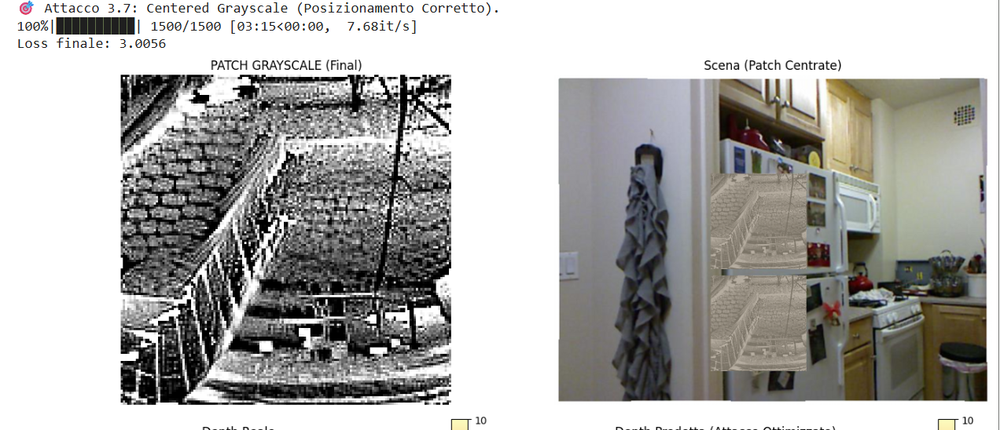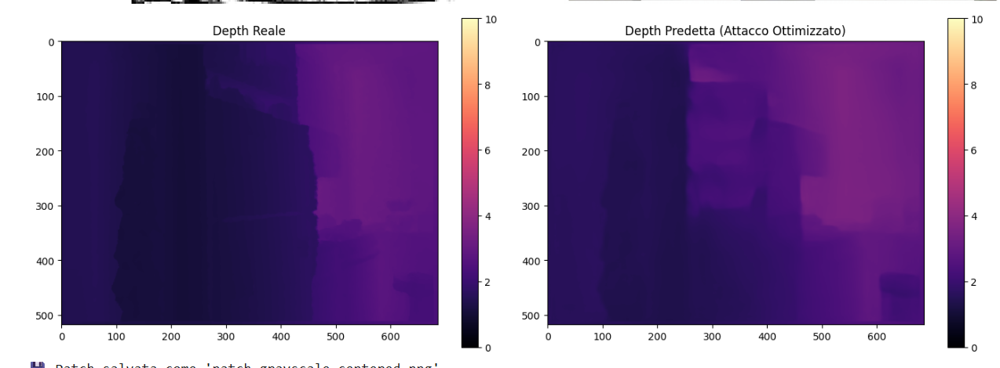

##5.6 REFINED SNIPER

In [ ]:
import torch
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
import random
import math
if ATTACCO5_6:
  # --- CONFIGURAZIONE "REFINED SNIPER" ---
  TARGET_DEPTH = 10.0
  PATCH_SIZE = (130, 130)
  LEARNING_RATE = 0.05
  ITERATIONS = 1500

  # NUOVE POSIZIONI (Spostate a destra)
  # X=350 allontana le patch dalla maniglia scura
  POS_ALTO  = (350, 230)
  POS_BASSO = (350, 390)

  # Jittering
  JITTER_RANGE = 20

  # --- SETUP ---
  sample_idx = 50
  sample = val_dataset[sample_idx]
  img_tensor = sample['image'].unsqueeze(0).to(DEVICE)
  depth_gt = sample['depth'].numpy()
  _, _, H, W = img_tensor.shape

  # Maschera Target (Stringiamo il focus sulla parte frontale piatta)
  mask_target_area = torch.zeros((1, 1, H, W)).to(DEVICE)
  mask_target_area[:, :, 150:480, 280:420] = 1.0

  # --- PATCH GRAYSCALE ---
  grayscale_patch = torch.rand((1, 1, PATCH_SIZE[1], PATCH_SIZE[0]), device=DEVICE, requires_grad=True)
  optimizer = optim.Adam([grayscale_patch], lr=LEARNING_RATE)

  # Funzione EOT
  def apply_random_transform(patch_tensor, device):
      angle = random.uniform(-15, 15) * (math.pi / 180.0)
      scale = random.uniform(0.9, 1.1)
      theta = torch.tensor([
          [math.cos(angle) / scale, -math.sin(angle) / scale, 0],
          [math.sin(angle) / scale, math.cos(angle) / scale, 0]
      ], dtype=torch.float, device=device).unsqueeze(0)
      grid = F.affine_grid(theta, patch_tensor.size(), align_corners=False)
      return F.grid_sample(patch_tensor, grid, align_corners=False, padding_mode='border')

  print(f"🎯 Attacco 3.8: Refined Sniper (130px, Spostate a Destra).")

  # --- TRAINING ---
  model.eval()
  losses = []

  for i in tqdm(range(ITERATIONS)):
      optimizer.zero_grad()

      patch_rgb = grayscale_patch.repeat(1, 3, 1, 1)
      trans_patch = apply_random_transform(patch_rgb, DEVICE)

      final_patch_canvas = torch.zeros_like(img_tensor)
      final_mask_canvas = torch.zeros_like(img_tensor)

      for center_x, center_y in [POS_ALTO, POS_BASSO]:
          jx = center_x + random.randint(-JITTER_RANGE, JITTER_RANGE)
          jy = center_y + random.randint(-JITTER_RANGE, JITTER_RANGE)

          y1, y2 = jy - PATCH_SIZE[1]//2, jy + PATCH_SIZE[1]//2
          x1, x2 = jx - PATCH_SIZE[0]//2, jx + PATCH_SIZE[0]//2

          if y1 < 0 or x1 < 0 or y2 > H or x2 > W: continue

          local_mask = torch.zeros_like(img_tensor)
          local_mask[:, :, y1:y2, x1:x2] = 1.0

          final_patch_canvas[:, :, y1:y2, x1:x2] = trans_patch
          final_mask_canvas = torch.max(final_mask_canvas, local_mask)

      img_adv = img_tensor * (1 - final_mask_canvas) + final_patch_canvas * final_mask_canvas
      noise = torch.randn_like(img_adv) * 0.02
      img_adv = (img_adv + noise).clamp(0, 1)

      pred_adv = model(img_adv)
      pred_adv = F.interpolate(pred_adv[:, None], (H, W), mode='bilinear', align_corners=True)

      pred_area = pred_adv * mask_target_area
      target_val = torch.ones_like(pred_adv) * TARGET_DEPTH * mask_target_area

      loss = F.mse_loss(pred_area, target_val)
      loss.backward()
      optimizer.step()

      with torch.no_grad():
          grayscale_patch.data.clamp_(0, 1)
      losses.append(loss.item())

  # --- VISUALIZZAZIONE ---
  print(f"Loss finale: {losses[-1]:.4f}")

  with torch.no_grad():
      patch_rgb_final = grayscale_patch.repeat(1, 3, 1, 1)
      patch_canvas = torch.zeros_like(img_tensor)
      mask_canvas = torch.zeros_like(img_tensor)

      for cx, cy in [POS_ALTO, POS_BASSO]:
          y1, y2 = cy - PATCH_SIZE[1]//2, cy + PATCH_SIZE[1]//2
          x1, x2 = cx - PATCH_SIZE[0]//2, cx + PATCH_SIZE[0]//2
          patch_canvas[:, :, y1:y2, x1:x2] = patch_rgb_final
          mask_canvas[:, :, y1:y2, x1:x2] = 1.0

      img_final = img_tensor * (1 - mask_canvas) + patch_canvas * mask_canvas
      pred_final = model(img_final)
      pred_final = F.interpolate(pred_final[:, None], depth_gt.shape[-2:], mode='bilinear')[0, 0].cpu().numpy()

  # PLOT
  fig, axes = plt.subplots(2, 2, figsize=(14, 10))

  patch_np = grayscale_patch[0, 0].detach().cpu().numpy()
  axes[0,0].imshow(patch_np, cmap='gray', vmin=0, vmax=1)
  axes[0,0].set_title("PATCH B&W (Definitiva)")
  axes[0,0].axis('off')

  img_vis = img_final[0].permute(1, 2, 0).cpu().numpy()
  img_vis = (img_vis * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])).clip(0, 1)
  axes[0,1].imshow(img_vis)
  axes[0,1].set_title("Posizionamento Corretto")
  axes[0,1].axis('off')

  im1 = axes[1,0].imshow(depth_gt, cmap='magma', vmin=0, vmax=10)
  axes[1,0].set_title("Depth Reale"); fig.colorbar(im1, ax=axes[1,0])

  im2 = axes[1,1].imshow(pred_final_np, cmap='magma', vmin=0, vmax=10)
  axes[1,1].set_title("Depth Predetta"); fig.colorbar(im2, ax=axes[1,1])

  plt.tight_layout()
  plt.show()



  # Definisci il percorso sul Drive
  drive_folder = '/content/'
  filename = 'patch_final_v2.png'
  full_path = os.path.join(drive_folder, filename)

  # Crea la cartella se non esiste (per sicurezza)
  os.makedirs(drive_folder, exist_ok=True)

  # Salva l'immagine direttamente sul Drive
  plt.imsave(full_path, patch_np, cmap='gray')

  print(f"💾 Patch salvata con successo su Drive in: {full_path}")
print("Ora puoi scaricarla comodamente dal tuo Google Drive per stamparla.")

Ora puoi scaricarla comodamente dal tuo Google Drive per stamparla.


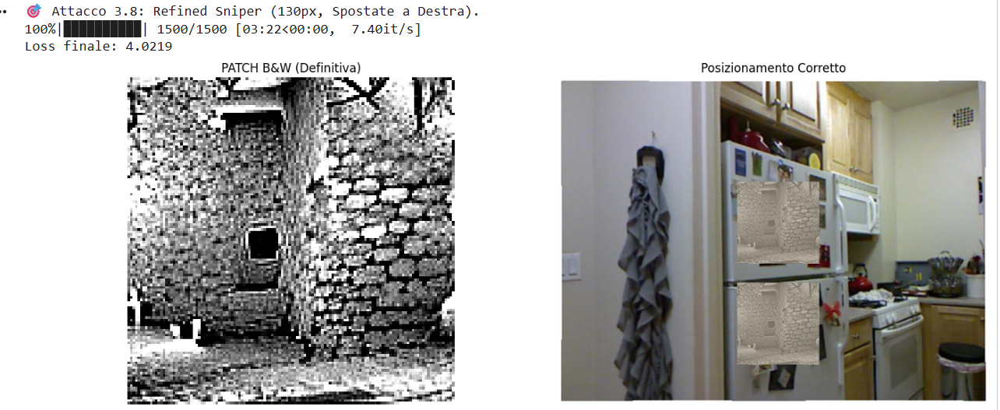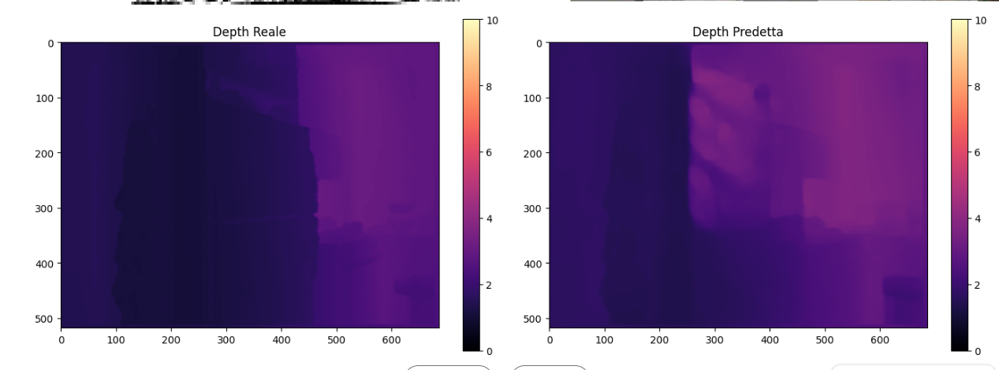

## Physical Validation

🤖 Caricamento Modello da: /content/drive/MyDrive/Vision/depth_anything_v2/checkpoints/latest.pth
✅ Modello caricato e pronto.

📸 Carica le tue foto:
1. Foto SENZA patch (Controllo)
2. Foto CON patch (Attacco)


Saving con_patch.jpg to con_patch (2).jpg
Saving senza_patch.jpg to senza_patch (2).jpg

📊 Elaborazione...
Processando: con_patch (2).jpg...
Processando: senza_patch (2).jpg...


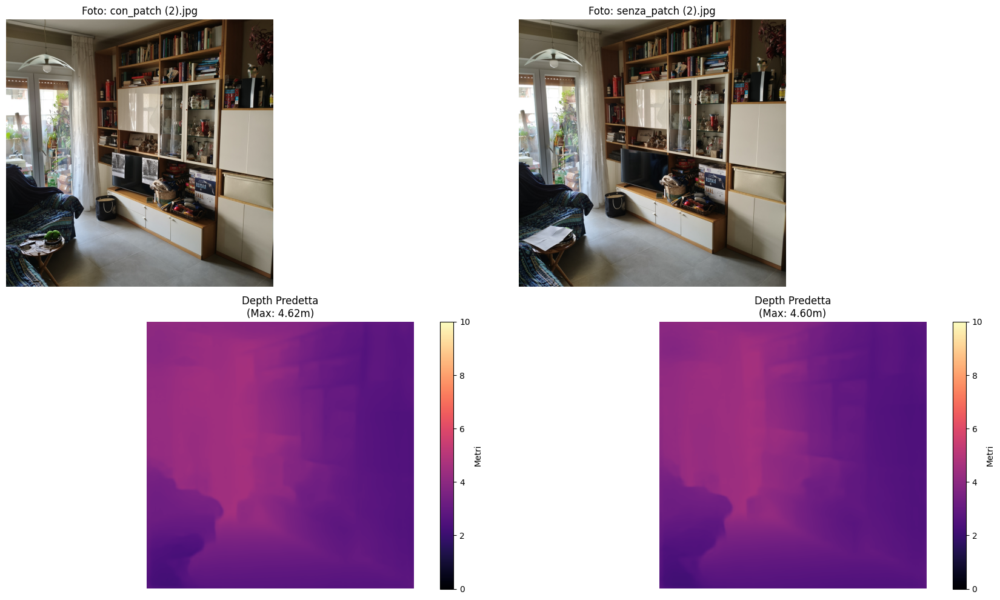

In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import sys
from google.colab import files

# --- 0. SETUP PATH (Per importare la libreria) ---
PROJECT_DIR = '/content/Depth-Anything-V2/metric_depth'
if os.path.exists(PROJECT_DIR):
    if PROJECT_DIR not in sys.path:
        sys.path.append(PROJECT_DIR)
    os.chdir(PROJECT_DIR)
else:
    print("⚠️ Attenzione: Directory del progetto non trovata. Gli import potrebbero fallire.")

from depth_anything_v2.dpt import DepthAnythingV2

# --- 1. CONFIGURAZIONE E CHECKPOINT ---
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
ENCODER = 'vits'
MAX_DEPTH = 10.0

# Logica di ricerca flessibile
if 'CHECKPOINT_DIR' in locals():
    SEARCH_DIR = CHECKPOINT_DIR
else:
    SEARCH_DIR = './checkpoints'

CHECKPOINT_PATH = None
BASE_MODEL = './depth_anything_v2_vits.pth'

# 1. Cerca 'latest.pth' nella directory di ricerca
if os.path.exists(os.path.join(SEARCH_DIR, 'latest.pth')):
    CHECKPOINT_PATH = os.path.join(SEARCH_DIR, 'latest.pth')
# 2. Cerca QUALSIASI file .pth nella directory (es. caricamento manuale con nome diverso)
elif os.path.exists(SEARCH_DIR):
    pth_files = [f for f in os.listdir(SEARCH_DIR) if f.endswith('.pth')]
    if pth_files:
        CHECKPOINT_PATH = os.path.join(SEARCH_DIR, pth_files[0])
        print(f"ℹ️ Trovato checkpoint alternativo: {pth_files[0]}")

# 3. Fallback sul modello base (scarica se necessario)
if CHECKPOINT_PATH is None:
    print("⬇️ Nessun checkpoint utente trovato. Controllo modello base...")
    if not os.path.exists(BASE_MODEL):
        print("⬇️ Scarico il modello base...")
        !wget -q -O {BASE_MODEL} https://huggingface.co/depth-anything/Depth-Anything-V2-Small/resolve/main/depth_anything_v2_vits.pth?download=true
    CHECKPOINT_PATH = BASE_MODEL

print(f"🤖 Caricamento Modello da: {CHECKPOINT_PATH}")

# Carica Modello (Pesi Congelati)
model_configs = {'vits': {'encoder': 'vits', 'features': 64, 'out_channels': [48, 96, 192, 384]}}
model = DepthAnythingV2(**{**model_configs[ENCODER], 'max_depth': MAX_DEPTH})

if os.path.exists(CHECKPOINT_PATH):
    try:
        checkpoint = torch.load(CHECKPOINT_PATH, map_location='cpu')

        if 'model' in checkpoint:
            state_dict = checkpoint['model']
        else:
            state_dict = checkpoint

        state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
        model.load_state_dict(state_dict, strict=False)
        model.to(DEVICE)
        model.eval()
        print("✅ Modello caricato e pronto.")
    except Exception as e:
        print(f"❌ Errore nel caricamento pesi: {e}")
else:
    raise FileNotFoundError("Errore critico: Impossibile trovare il file checkpoint!")

# --- 2. CARICAMENTO FOTO DAL MONDO REALE ---
print("\n📸 Carica le tue foto (Confronto Attacco vs Controllo):")
print("Suggerimento: Carica 2 file (es. 'con_patch.jpg' e 'senza_patch.jpg')")
uploaded = files.upload()

# Ordina i file caricati
filenames = list(uploaded.keys())
if len(filenames) < 1:
    print("⚠️ Nessun file caricato.")
elif len(filenames) < 2:
    print("⚠️ Nota: Hai caricato solo 1 foto. Il confronto sarà limitato.")

# --- 3. FUNZIONE DI INFERENZA ---
def predict_depth(image_path):
    # Leggi immagine
    raw_image = cv2.imread(image_path)
    if raw_image is None:
        print(f"Errore lettura immagine: {image_path}")
        return None, None

    raw_image = cv2.cvtColor(raw_image, cv2.COLOR_BGR2RGB)

    # Resize per la rete (mantiene aspect ratio, pad a multipli di 14)
    h, w = raw_image.shape[:2]
    input_size = 518
    scale = input_size / max(h, w)
    new_h, new_w = int(h * scale), int(w * scale)
    new_h = (new_h // 14) * 14
    new_w = (new_w // 14) * 14

    if new_h == 0 or new_w == 0:
         new_h, new_w = 14, 14

    img_resized = cv2.resize(raw_image, (new_w, new_h))

    # Normalizzazione
    img_tensor = torch.from_numpy(img_resized).float() / 255.0
    mean = torch.tensor([0.485, 0.456, 0.406])
    std = torch.tensor([0.229, 0.224, 0.225])
    img_tensor = (img_tensor - mean) / std

    img_tensor = img_tensor.permute(2, 0, 1).unsqueeze(0).to(DEVICE)

    # Inferenza
    with torch.no_grad():
        depth = model(img_tensor)
        depth = F.interpolate(depth[:, None], (h, w), mode='bilinear', align_corners=True)[0, 0]

    return raw_image, depth.cpu().numpy()

# --- 4. VISUALIZZAZIONE CONFRONTO ---
if len(filenames) > 0:
    print("\n📊 Elaborazione e Visualizzazione...")

    # Adatta la dimensione della figura
    plt.figure(figsize=(10 * len(filenames), 10))

    for i, fname in enumerate(filenames):
        print(f"Processando: {fname}...")
        img, depth = predict_depth(fname)

        if img is None: continue

        # Colonna 1: Foto
        plt.subplot(2, len(filenames), i + 1)
        plt.imshow(img)
        plt.title(f"Foto: {fname}")
        plt.axis('off')

        # Colonna 2: Depth Map
        plt.subplot(2, len(filenames), i + 1 + len(filenames))
        im = plt.imshow(depth, cmap='magma', vmin=0, vmax=10) # Scala fissa 0-10m
        plt.title(f"Depth Predetta\n(Max: {depth.max():.2f}m)")
        plt.axis('off')
        plt.colorbar(im, label='Metri', fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()

### small patch / AI mode

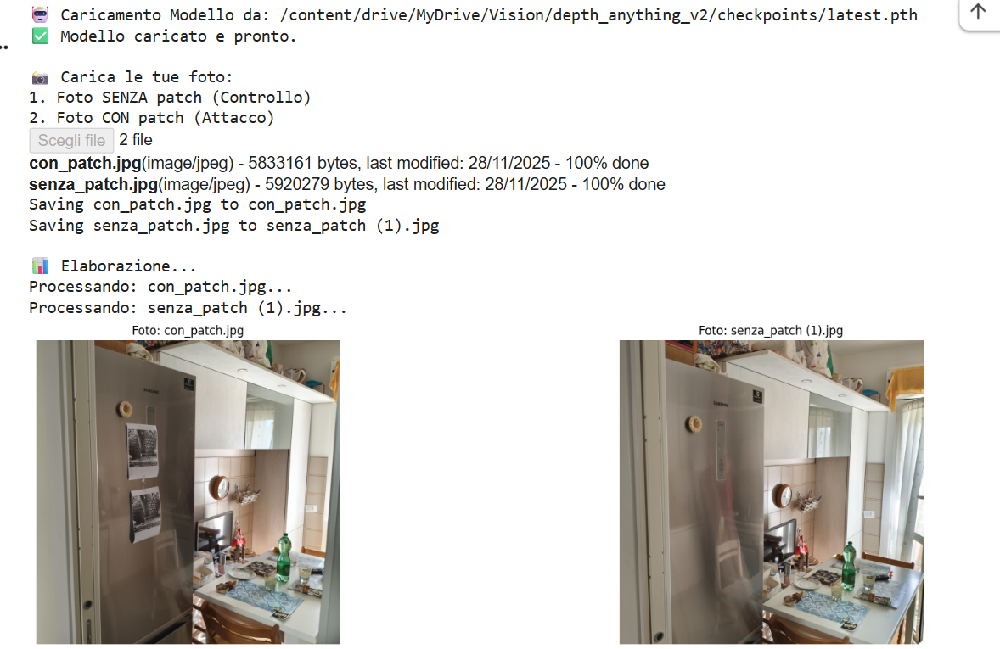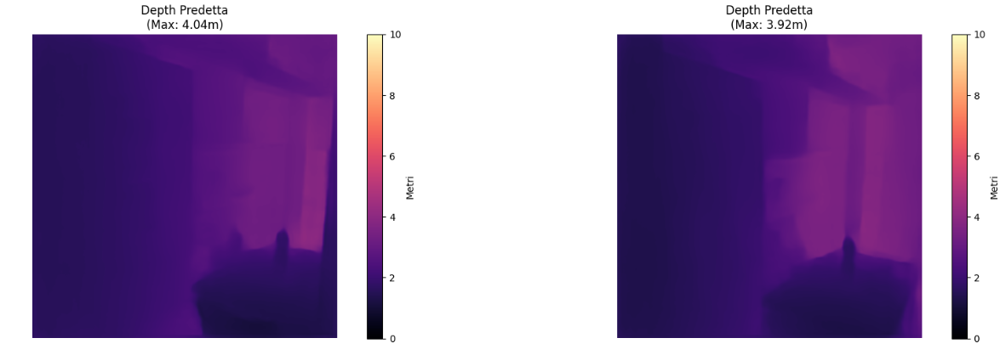

### small patch / Pro mode

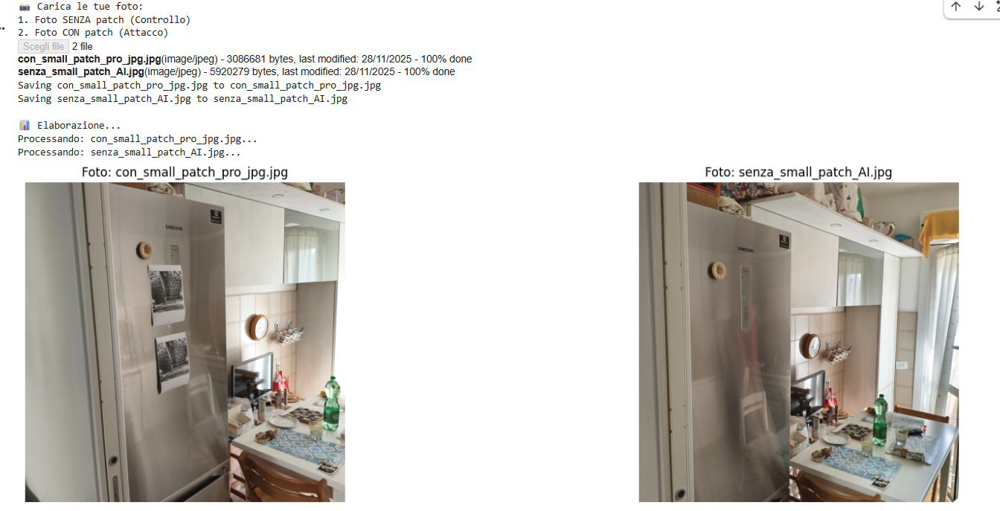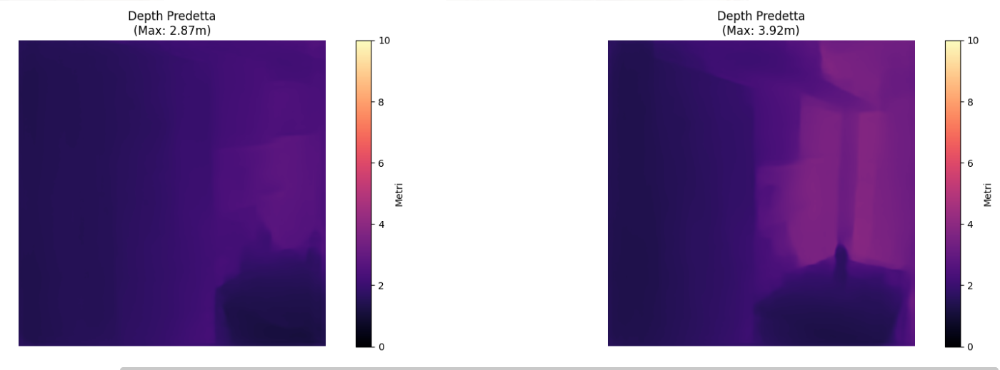

### Big Patch / AI mode

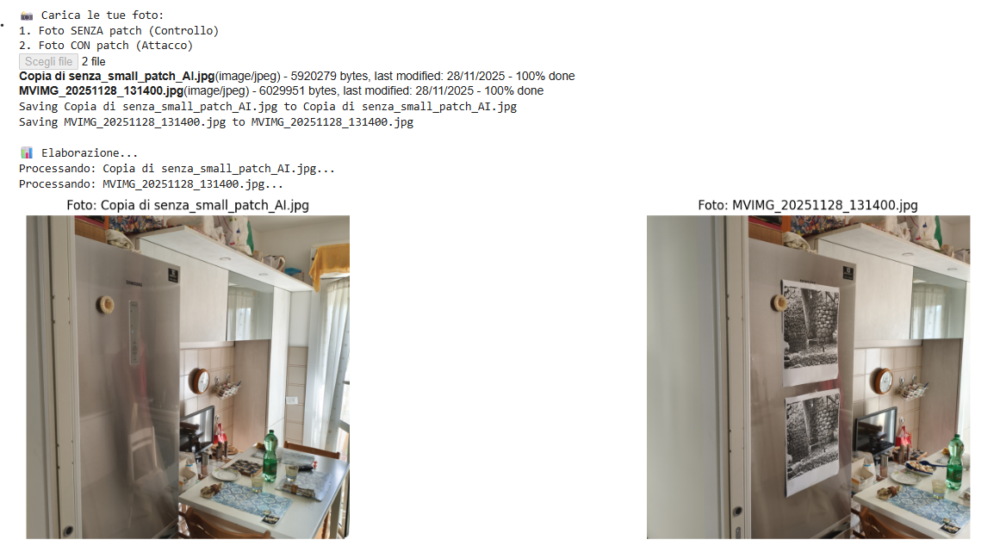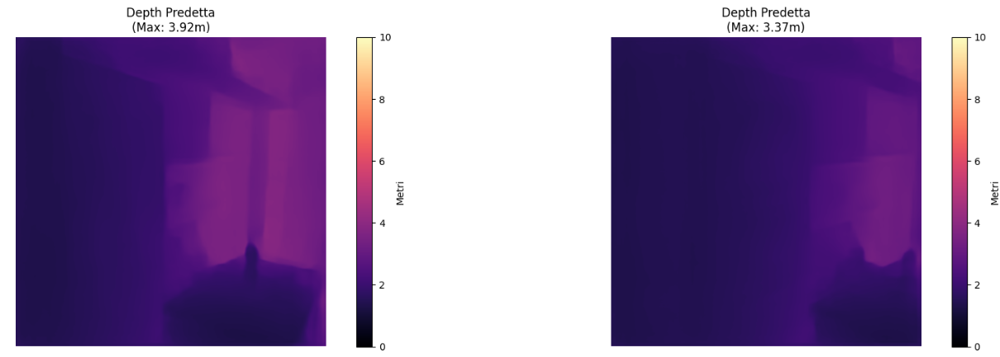

### Big patch / Pro mode / natural light

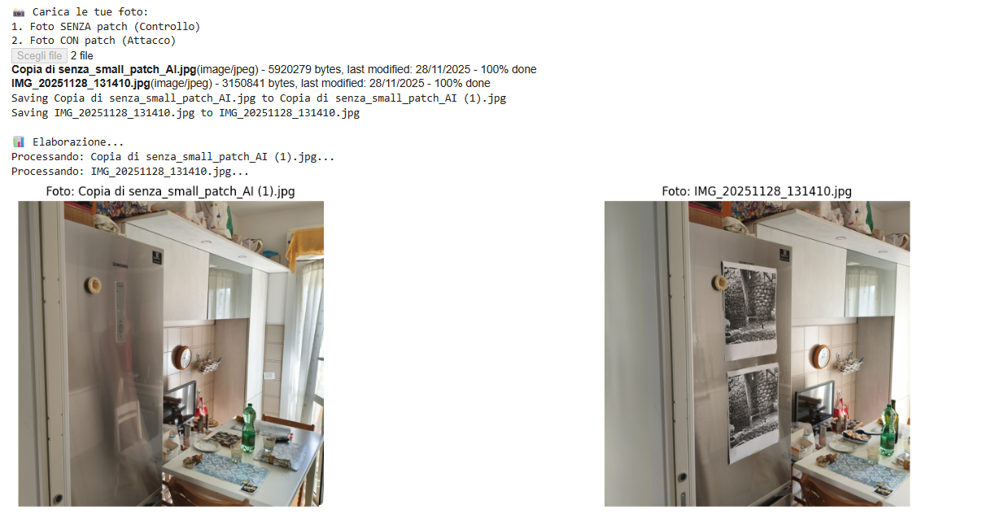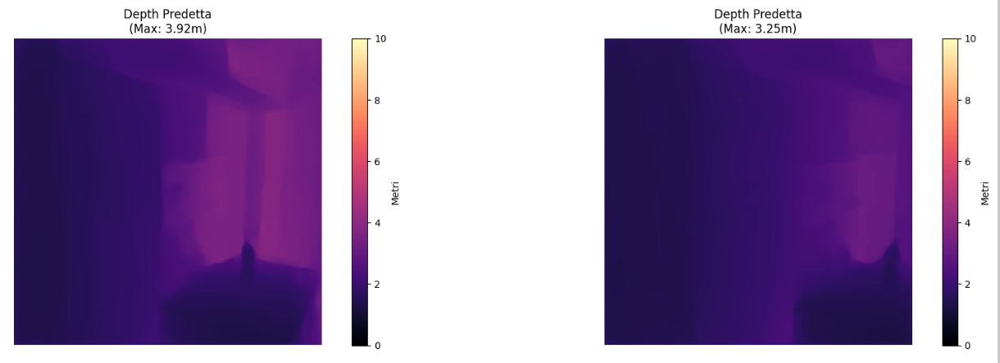

### Big Patch / pro / dark light

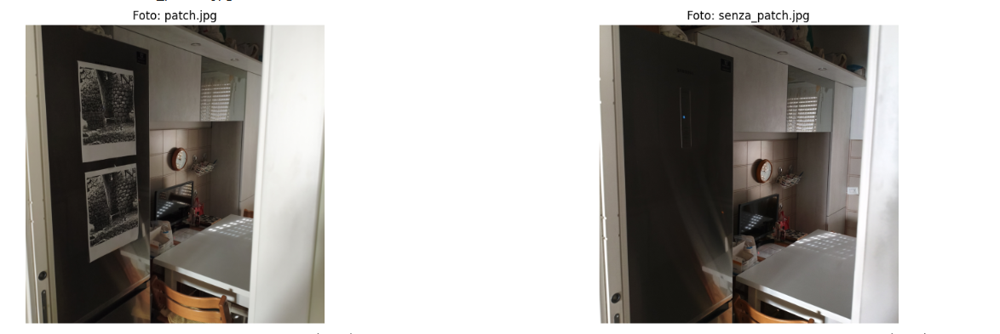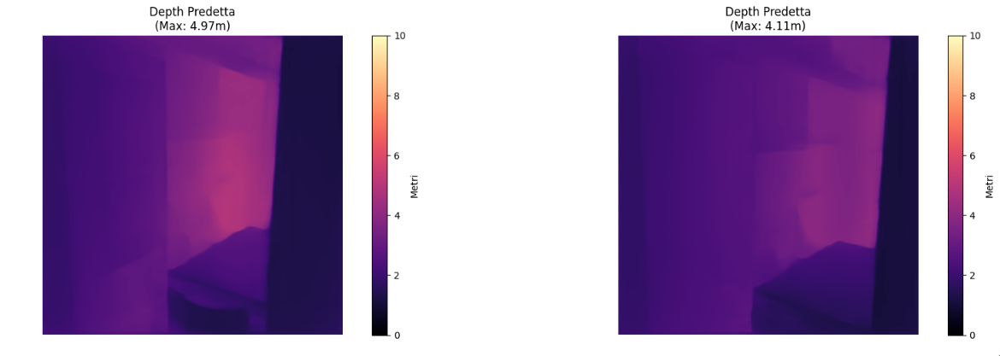

### Bp / pro / 180°  / natural light

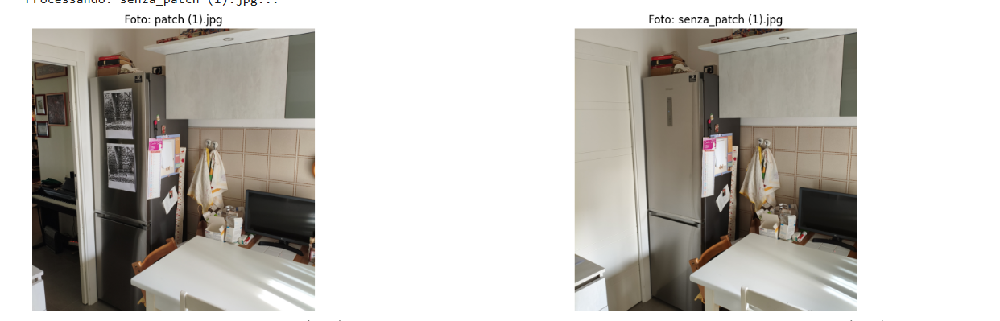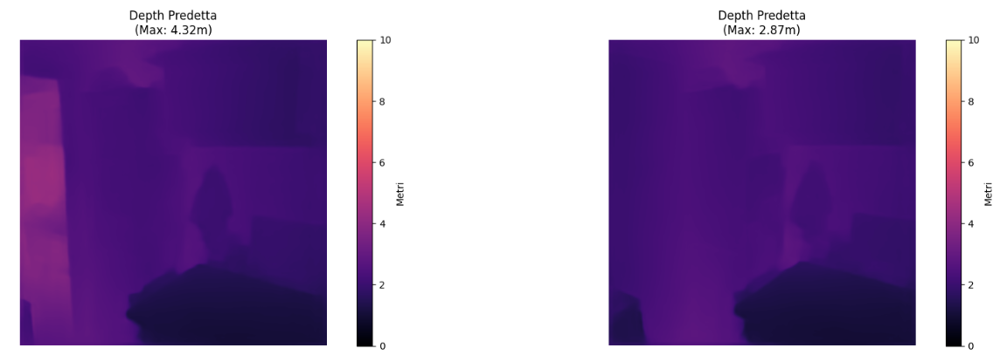

### Bp / pro / 180°  / Dark light

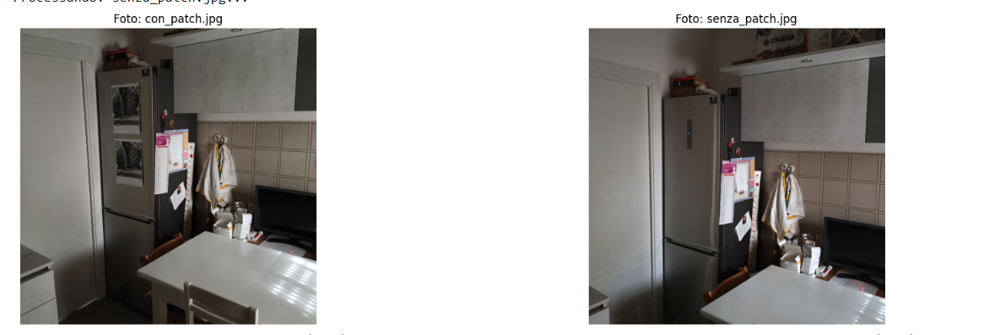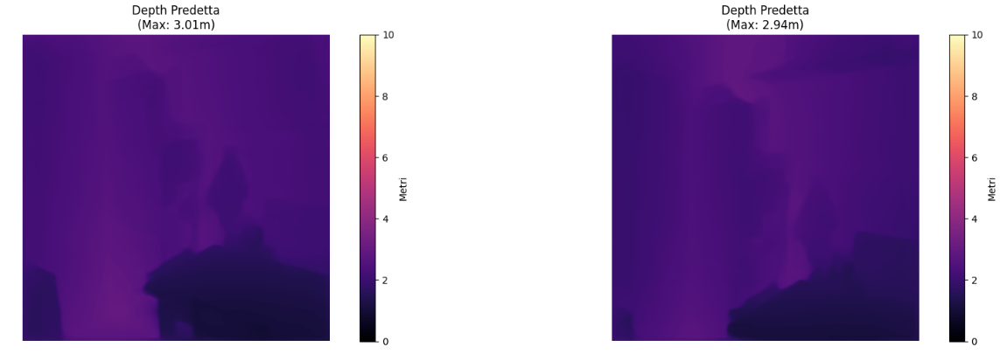

### Bp / pro / Frontal  / natural light

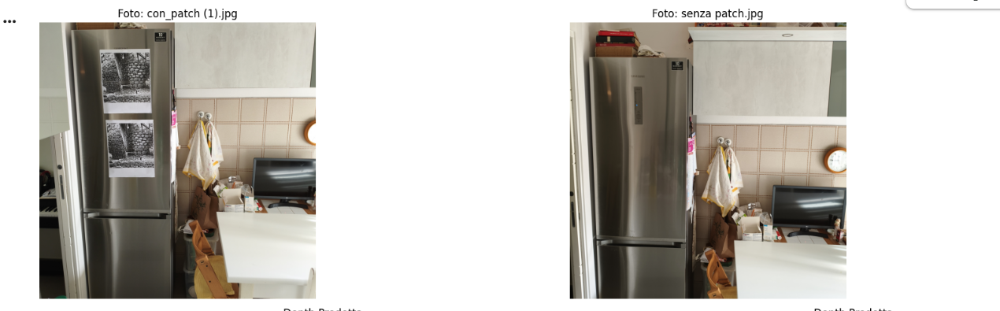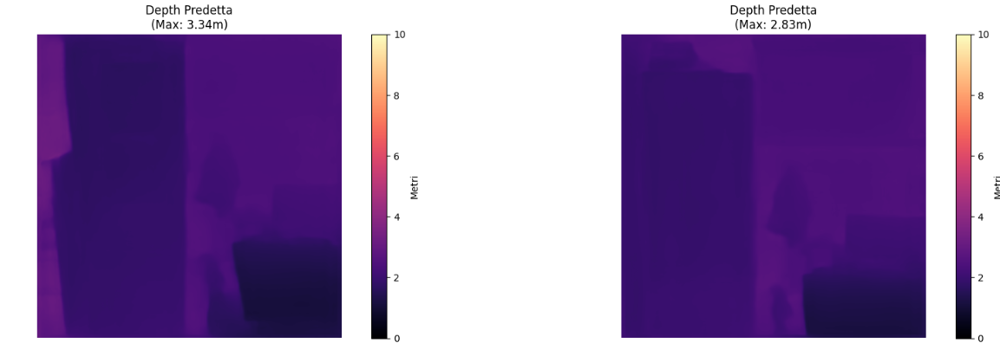

### Bp / pro / Frontal  / Dark light

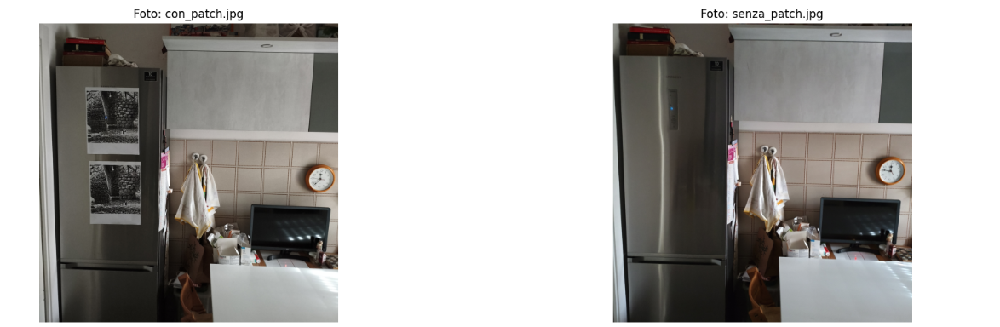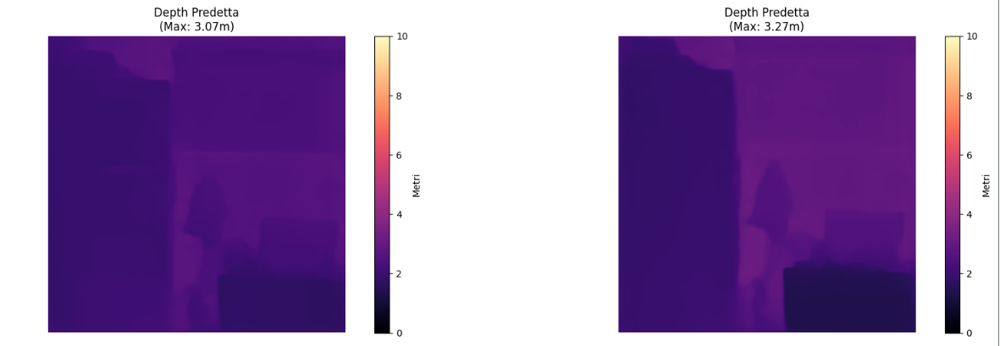

### Bp / pro / TV scene / natural Light

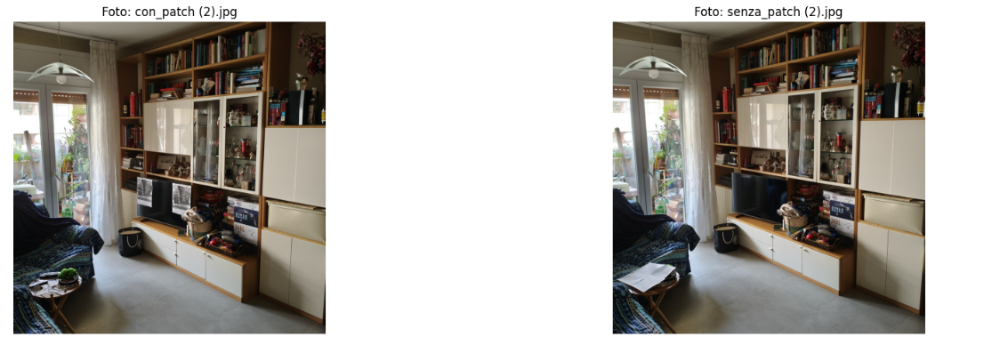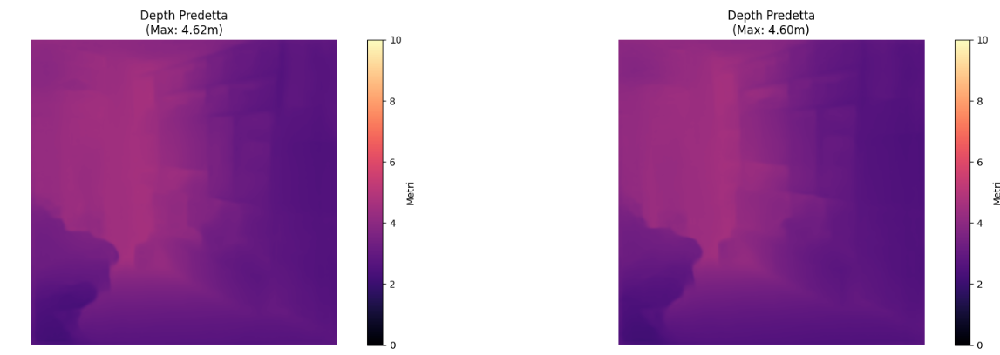

### Bp / pro / TV scene / Dark Light

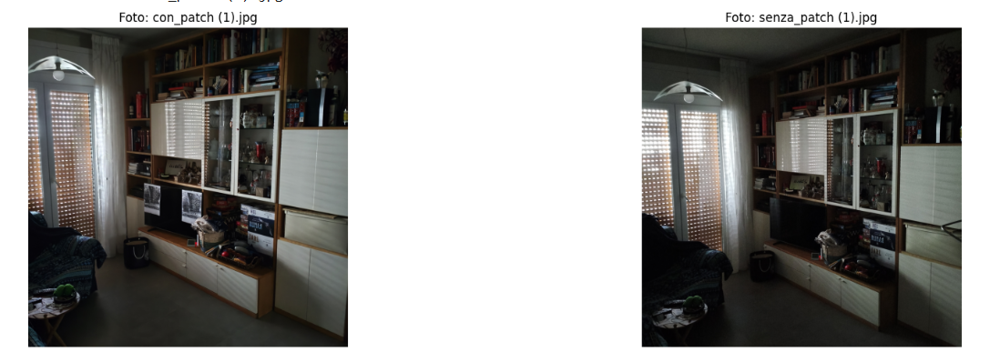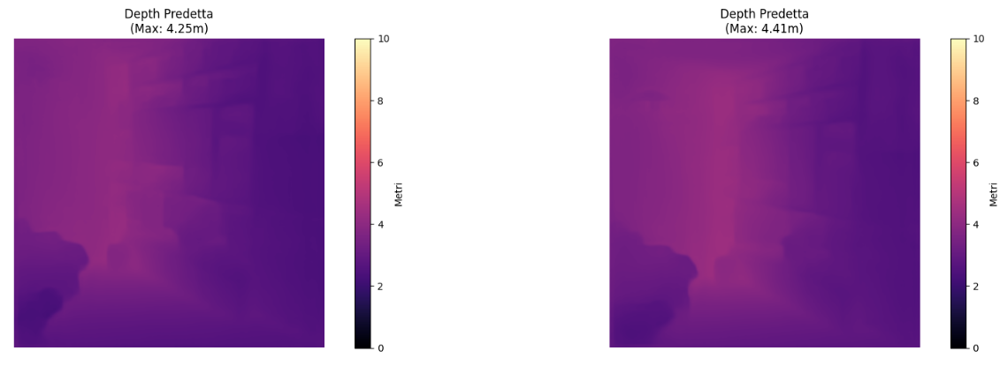